In [1]:
%load_ext autoreload
%autoreload 2

import util
import deblur

from IPython.display import display, clear_output
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import convolve, correlate
from skimage.measure import compare_psnr, compare_ssim

# 1. Blur Kernel Generation

# 1.1 Gaussian Kernel

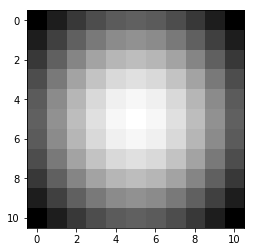

In [2]:
kernel = util.gen_gaussian_kernel(5, sig=5)
plt.imshow(kernel, cmap='gray')

# 1.2 Sample Image

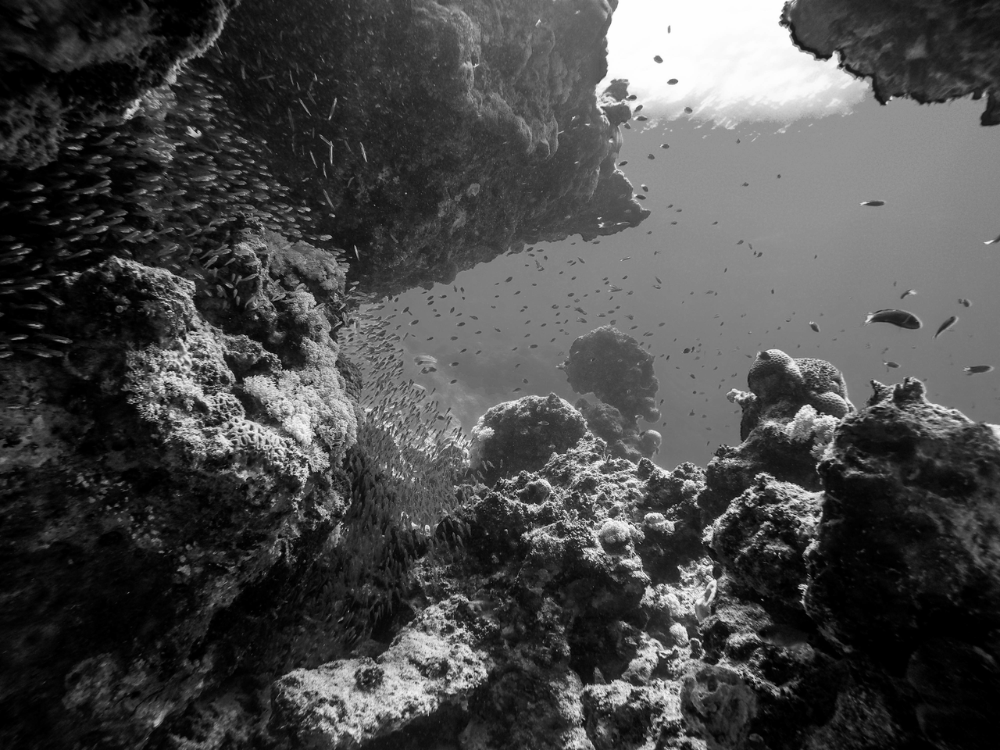

In [3]:
image = util.read_grey_image('sea.png')
display(util.to_pil(image))

# 1.3 Blurred Image

### 1.3.1 Blur Image with `convolve`

PSNR: 22.920073; SSIM: 0.757147


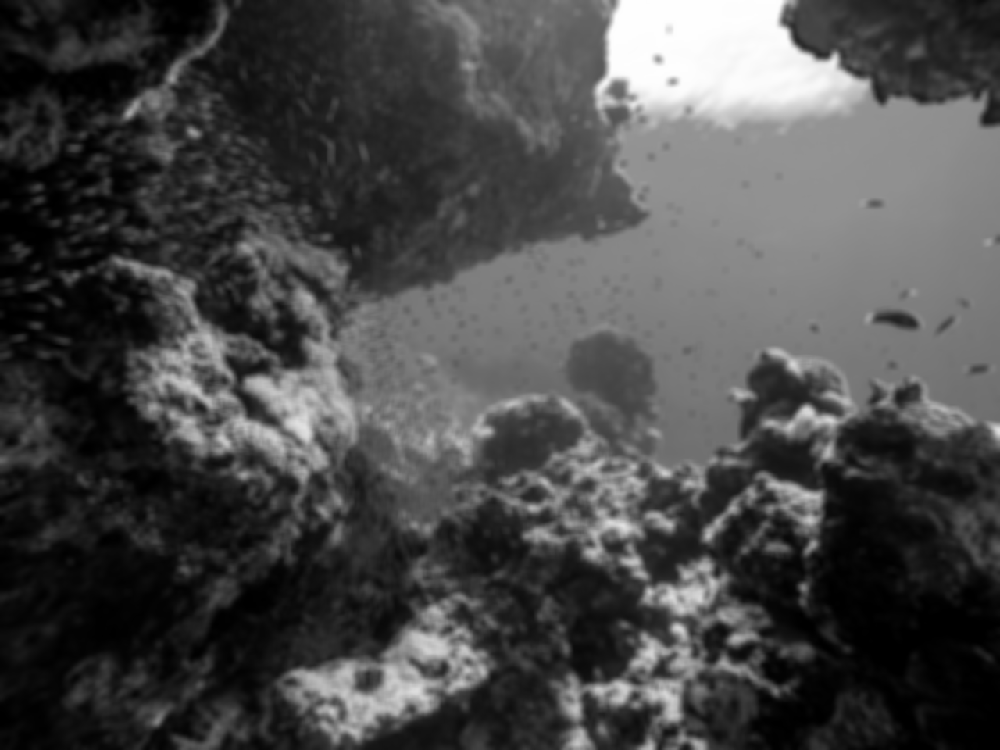

In [4]:
blurred = convolve(image, kernel)
print('PSNR: {:.6f}; SSIM: {:.6f}'.format(compare_psnr(blurred, image), compare_ssim(blurred, image)))
util.to_pil(blurred)

<!--- ## 1.3.2 Blur Image with Different Kernels -->

### 1.3.2 Add different levels of noise to blurred image

We add 6 different levels of Gaussian noises to images.

Sigma: 0; PSNR: 22.920073; SSIM: 0.757147


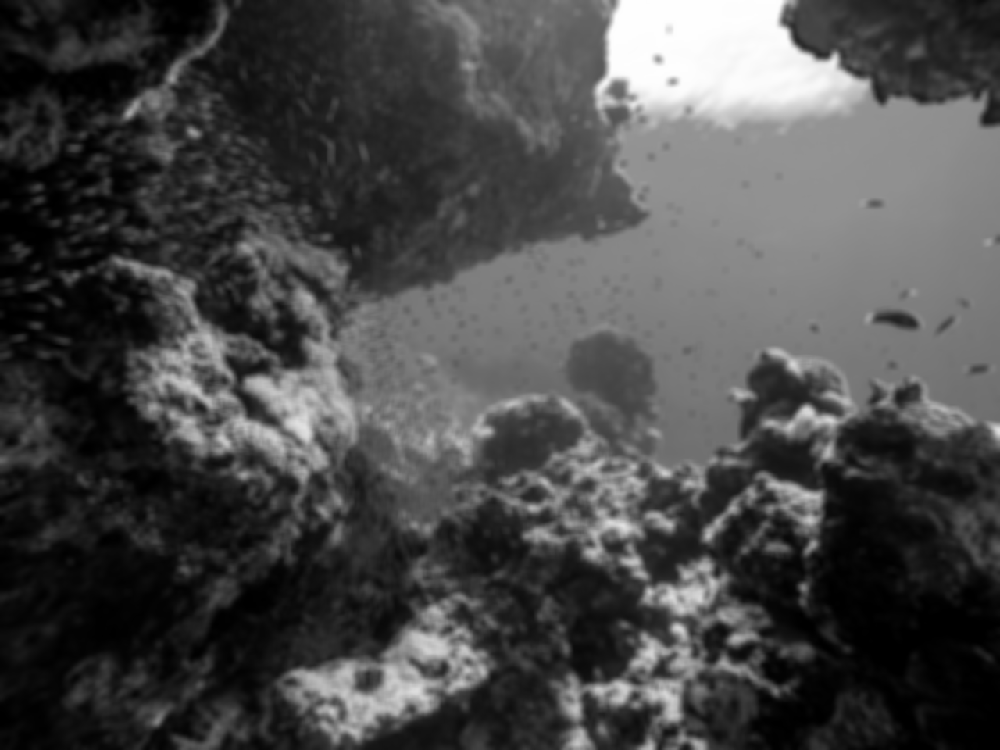

Sigma: 0.0005; PSNR: 22.919853; SSIM: 0.757104


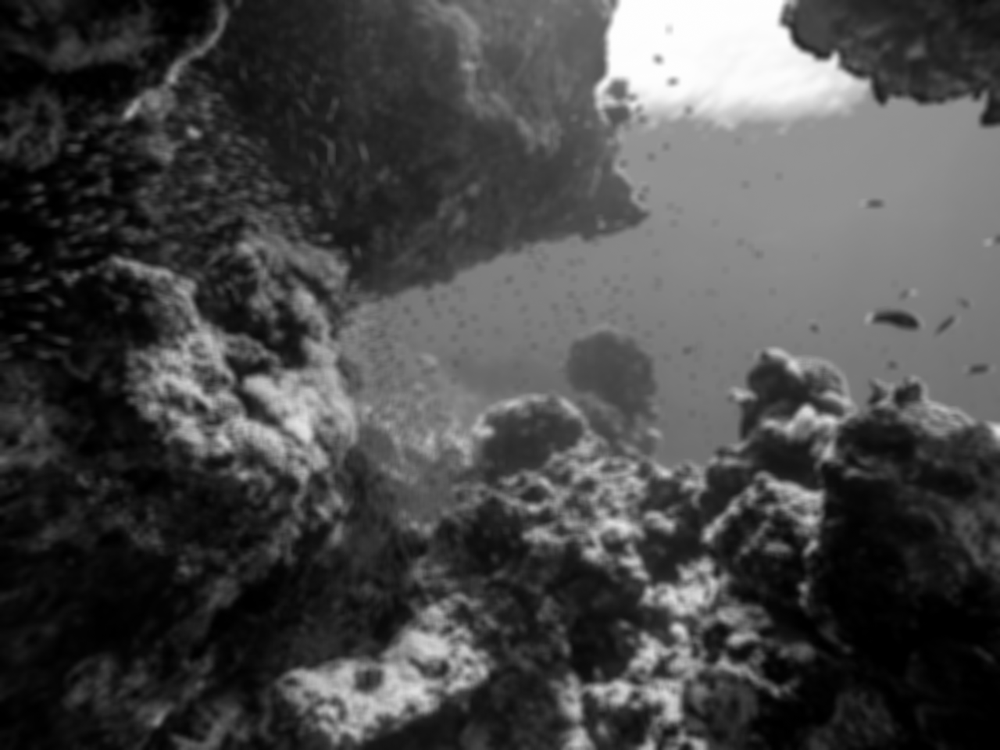

Sigma: 0.001; PSNR: 22.919144; SSIM: 0.756985


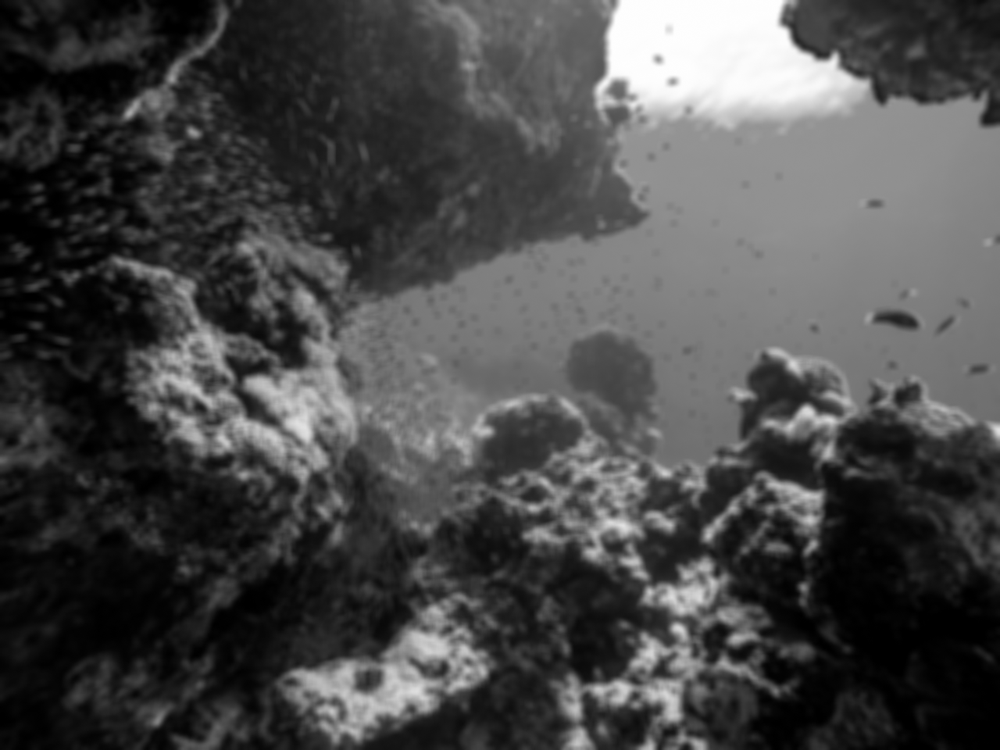

Sigma: 0.005; PSNR: 22.898004; SSIM: 0.753082


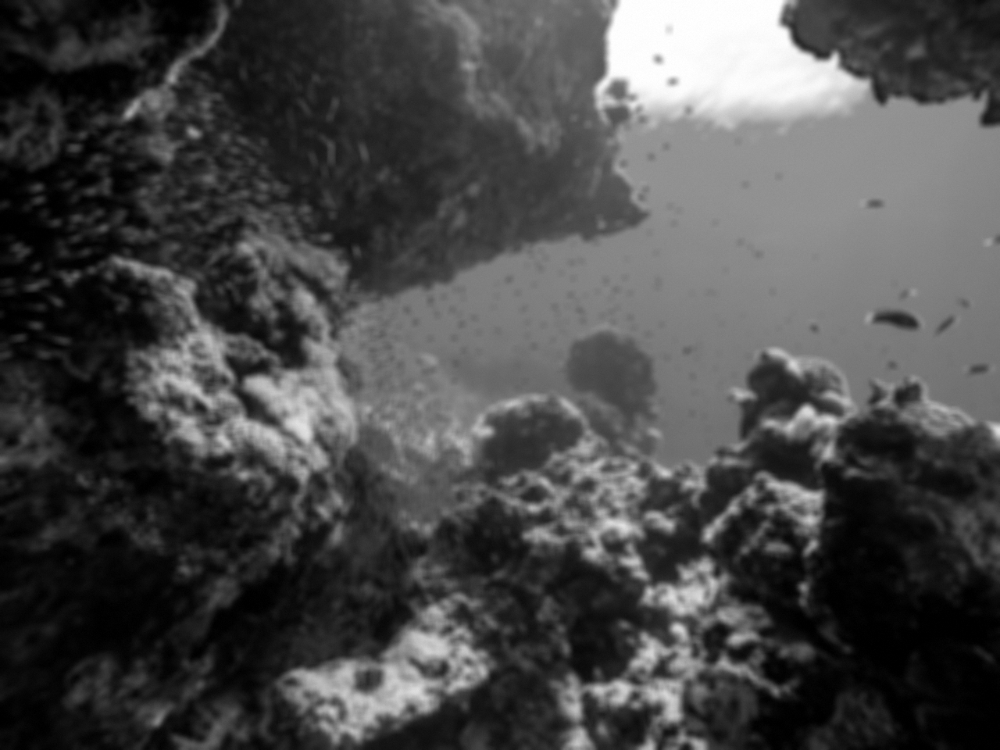

Sigma: 0.01; PSNR: 22.837626; SSIM: 0.741342


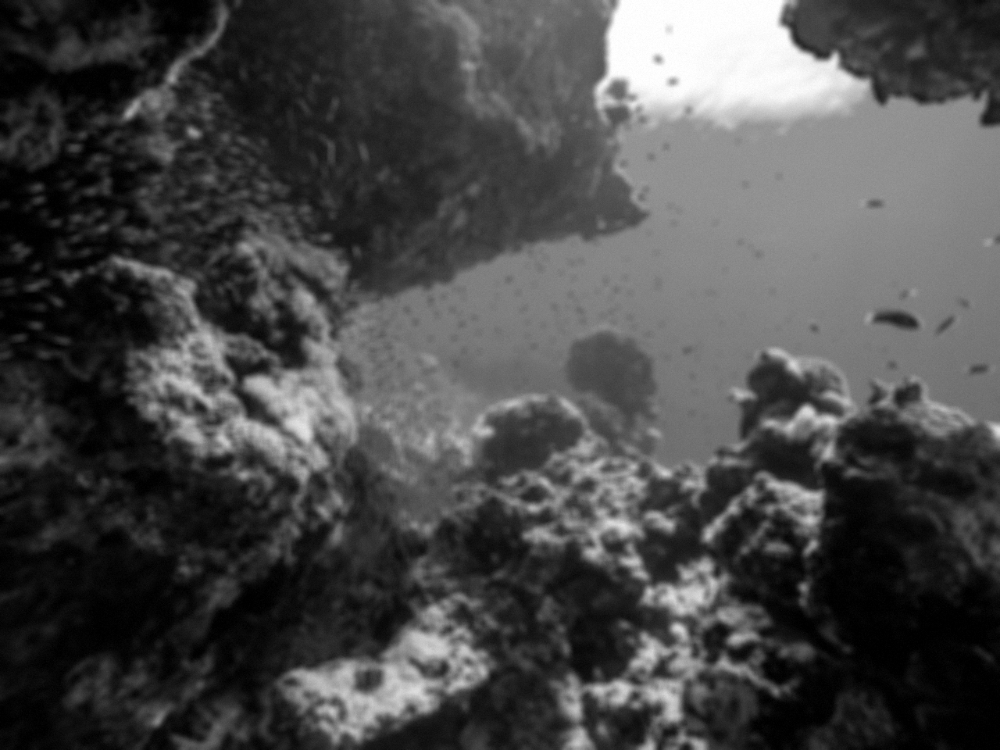

Sigma: 0.05; PSNR: 21.291767; SSIM: 0.516028


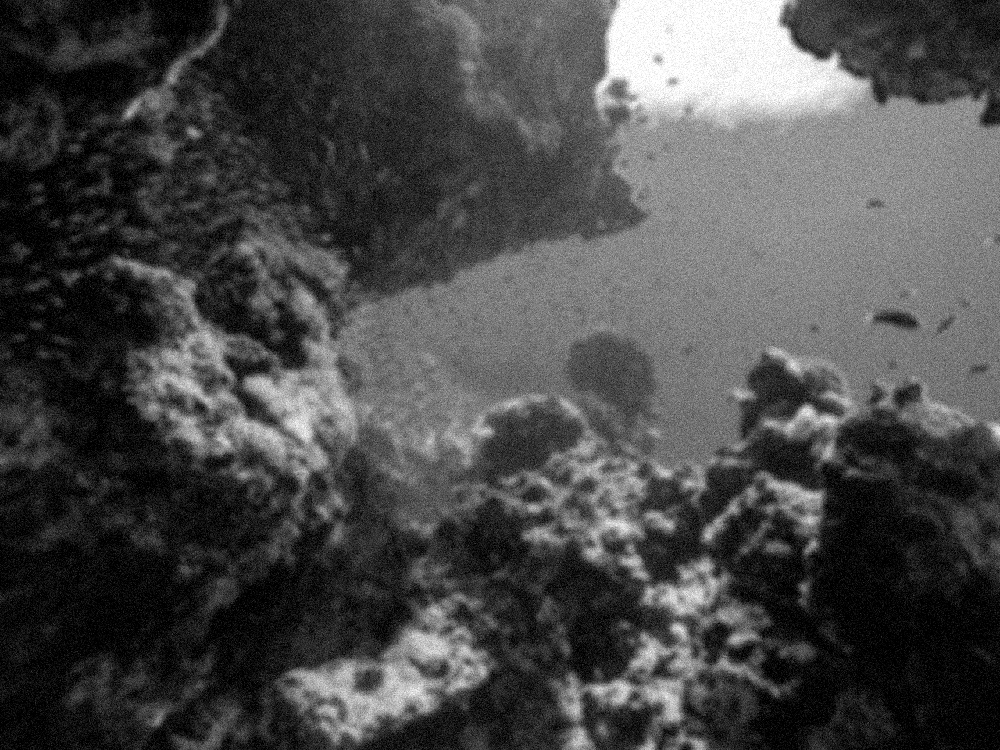

In [5]:
noise_levels = [0, 0.0005, 0.001, 0.005, 0.01, 0.05]
lmbda = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2]
distorted_images = [(blurred + np.random.randn(*blurred.shape) * sigma).clip(0, 1) for sigma in noise_levels]
psnr_blurred = []
ssim_blurred = []
for distorted_image, sigma in zip(distorted_images, noise_levels):
    psnr = compare_psnr(distorted_image, image)
    ssim = compare_ssim(distorted_image, image)
    psnr_blurred.append(psnr)
    ssim_blurred.append(ssim)
    
    print('Sigma: {}; PSNR: {:.6f}; SSIM: {:.6f}'.format(sigma, psnr, ssim))
    display(util.to_pil(distorted_image))

# 2. Least Square Solver

## 2.1 Solve Matrix Inverse with Conjugate Gradient

Suppose $P$ is toeplitz matrix of kernel $K$ and $b$ is blurred image, then deblurring can be solved with 
$$x = P^{-1}b.$$
Conjugate gradient is a least squares solver which does not need to know the individual entries of matrix $P$ to solve a linear system $Px=b.$ It only requires the results of matrix-vector products which can be easily implemented with [`scipy.ndimage.convolve`](https://docs.scipy.org/doc/scipy-1.0.0/reference/generated/scipy.ndimage.convolve.html).

Here we abstract the blurring operator as a virtual linear operator. Then we use conjugate gradient to solve this linear equations.

Sigma: 0; PSNR: 30.093373; SSIM: 0.928798


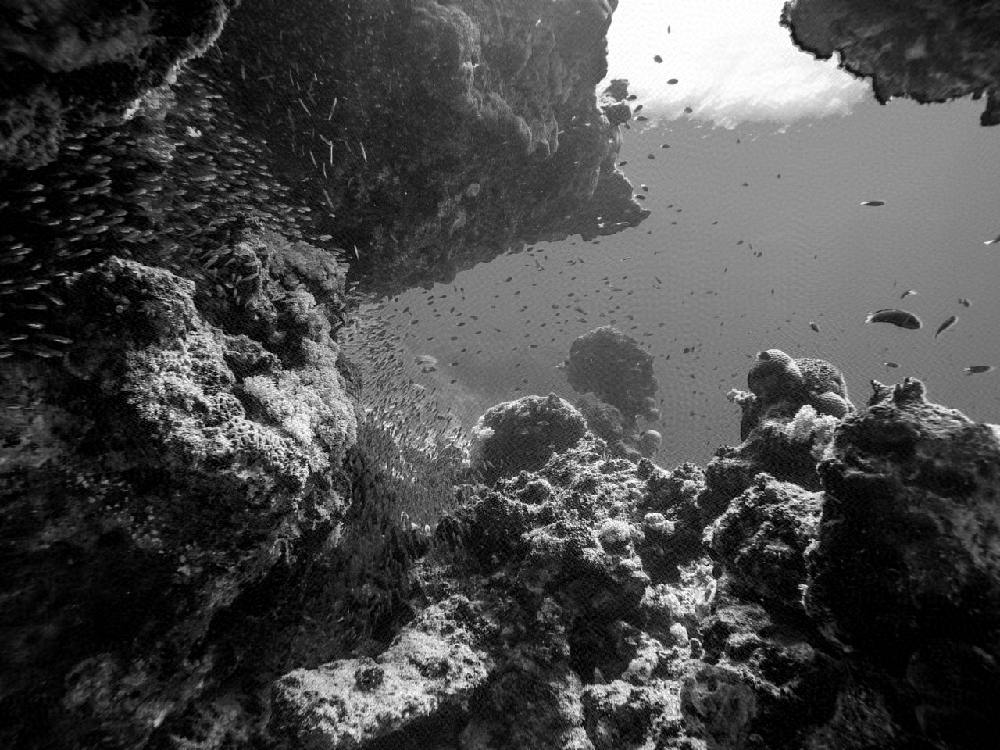

Sigma: 0.0005; PSNR: 10.932159; SSIM: 0.106141


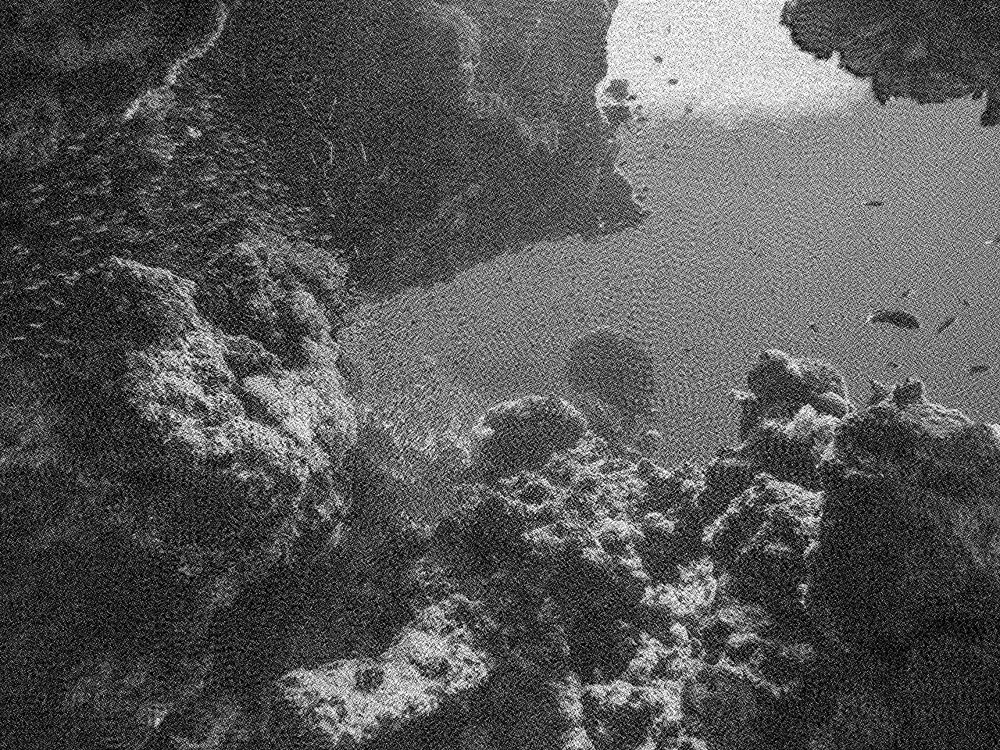

Sigma: 0.001; PSNR: 7.242694; SSIM: 0.040118


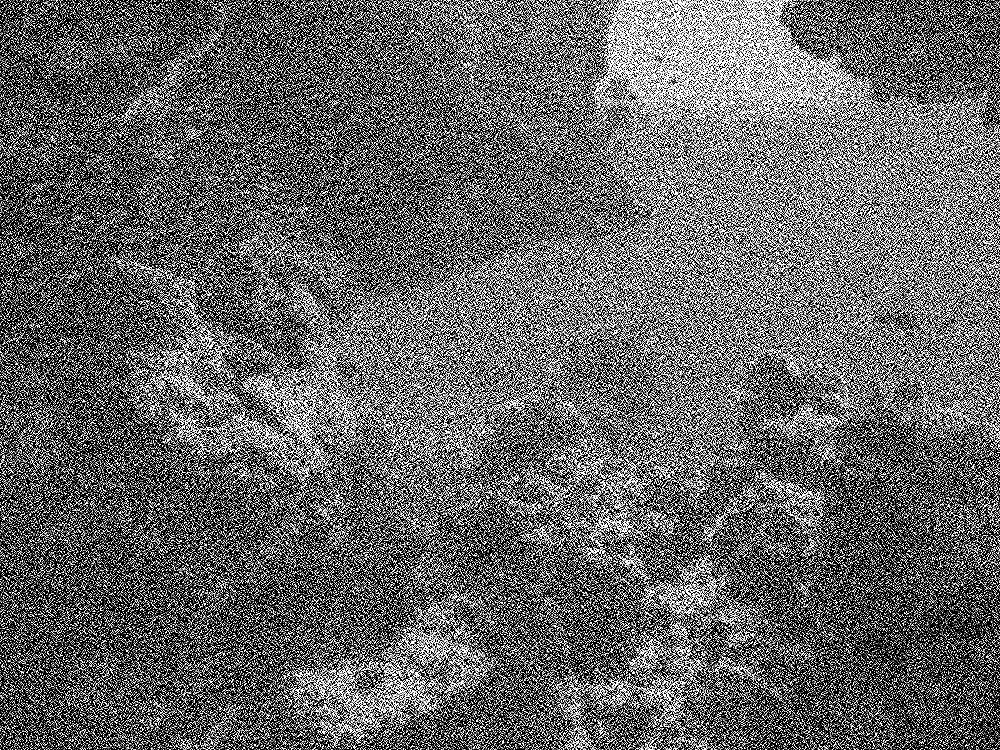

Sigma: 0.005; PSNR: 4.861917; SSIM: 0.012059


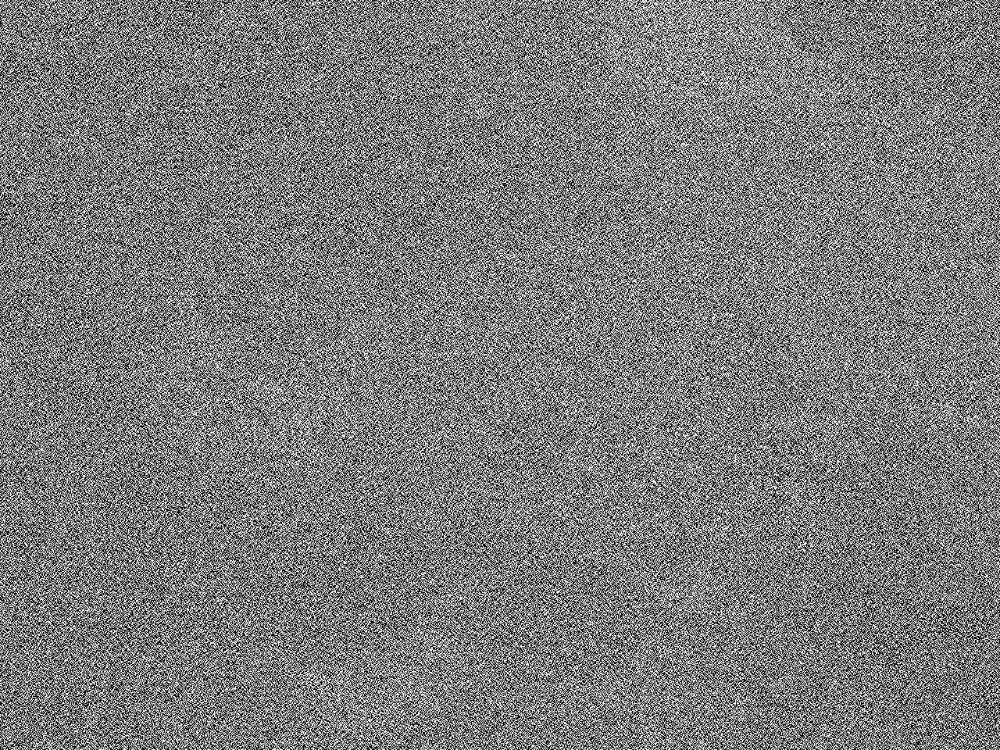

Sigma: 0.01; PSNR: 4.647680; SSIM: 0.010260


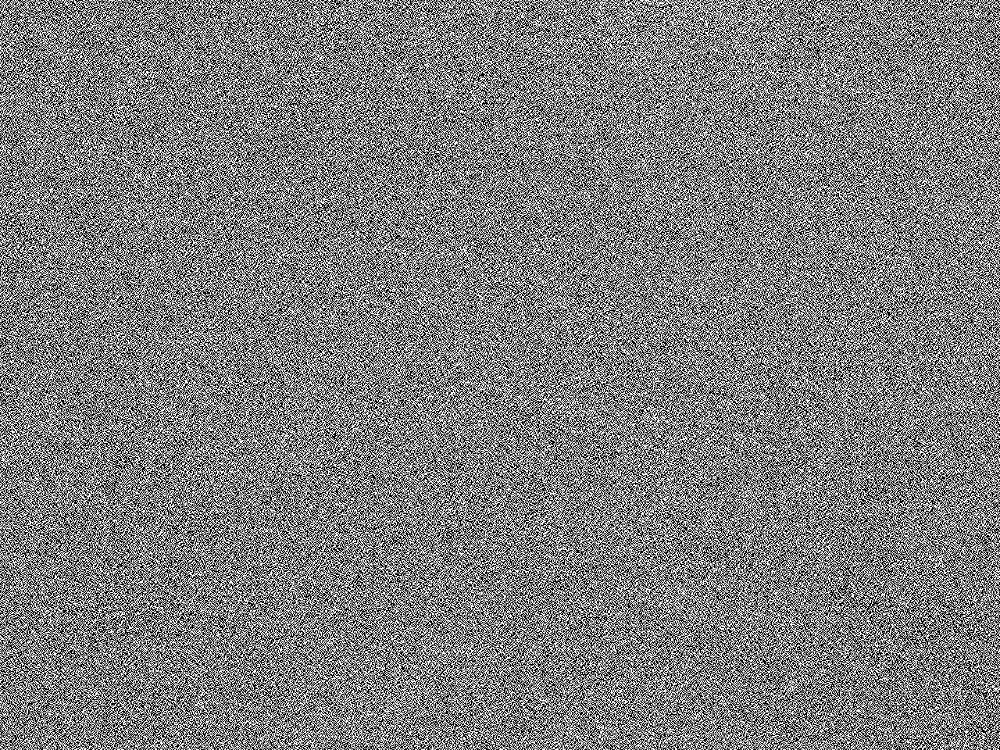

Sigma: 0.05; PSNR: 4.491968; SSIM: 0.009071


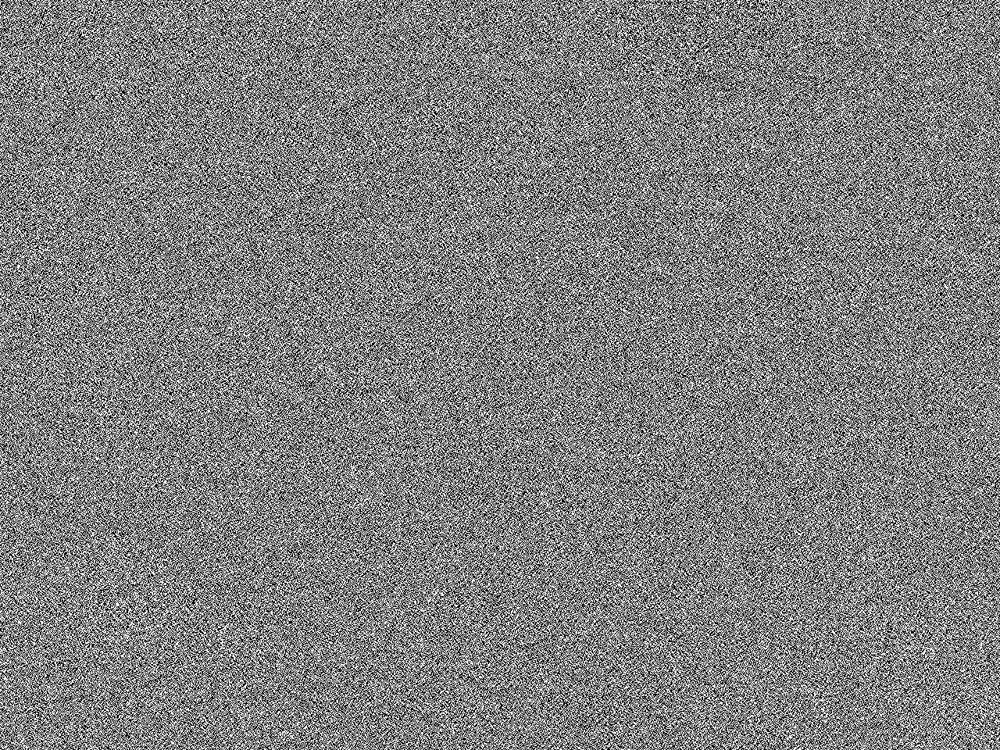

In [6]:
output_cg = []
psnr_cg = []
ssim_cg = []
for sigma, distorted_image in zip(noise_levels, distorted_images):
    o = deblur.deblur(kernel, distorted_image)
    output_cg.append(o)
    
    psnr = compare_psnr(o, image)
    psnr_cg.append(psnr)
 
    ssim = compare_ssim(o, image)
    ssim_cg.append(ssim)
    
    print('Sigma: {}; PSNR: {:.6f}; SSIM: {:.6f}'.format(sigma, psnr, ssim))
    display(util.to_pil(o))

## 2.2 Solve Normal Equations

Alternatively, we can also solve the normal equations:
$$P^TPx=P^Tb.$$
$P^Tx$ is implemented with [`scipy.ndimage.correlate`](https://docs.scipy.org/doc/scipy-1.0.0/reference/generated/scipy.ndimage.convolve.html).

Sigma: 0; PSNR: 30.496649; SSIM: 0.950284


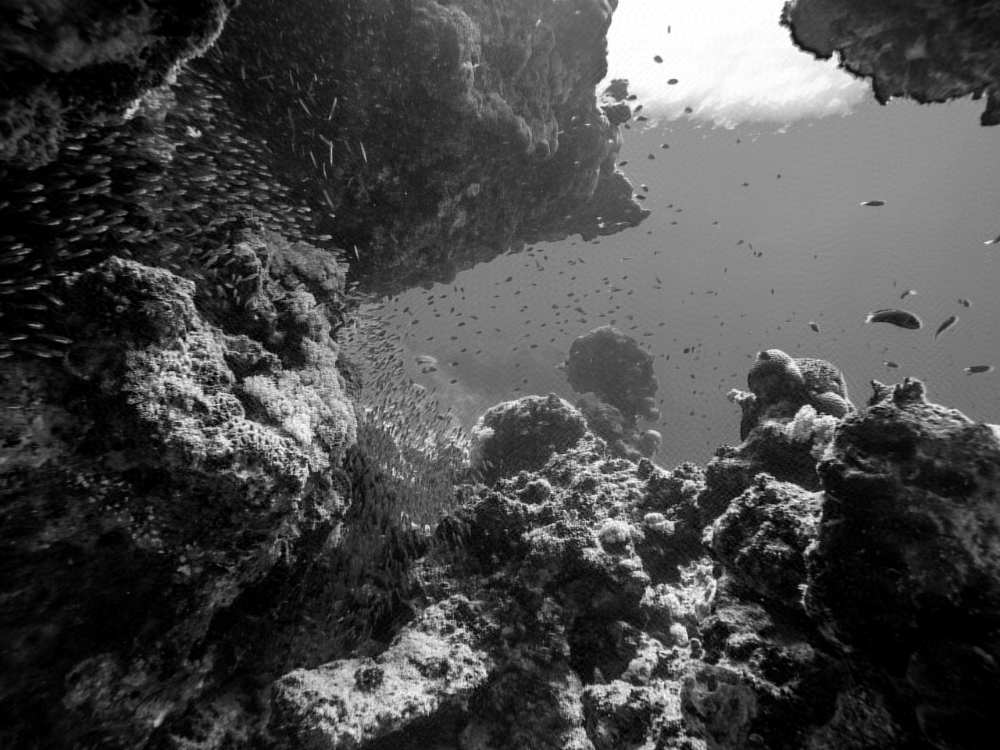

Sigma: 0.0005; PSNR: 27.145029; SSIM: 0.804359


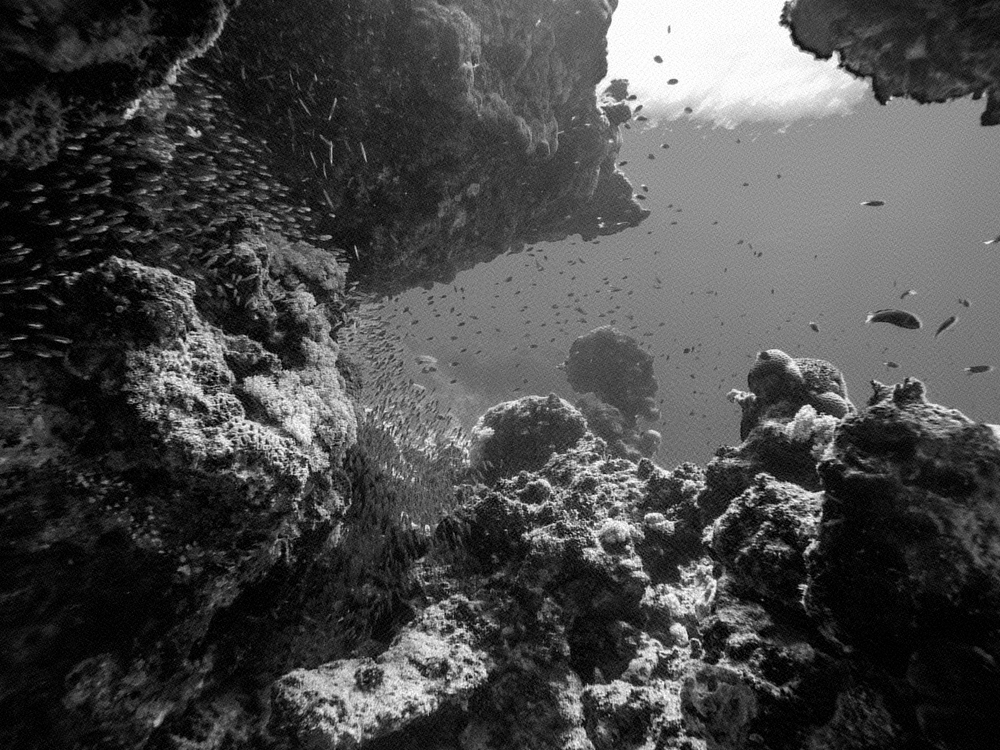

Sigma: 0.001; PSNR: 21.728622; SSIM: 0.520517


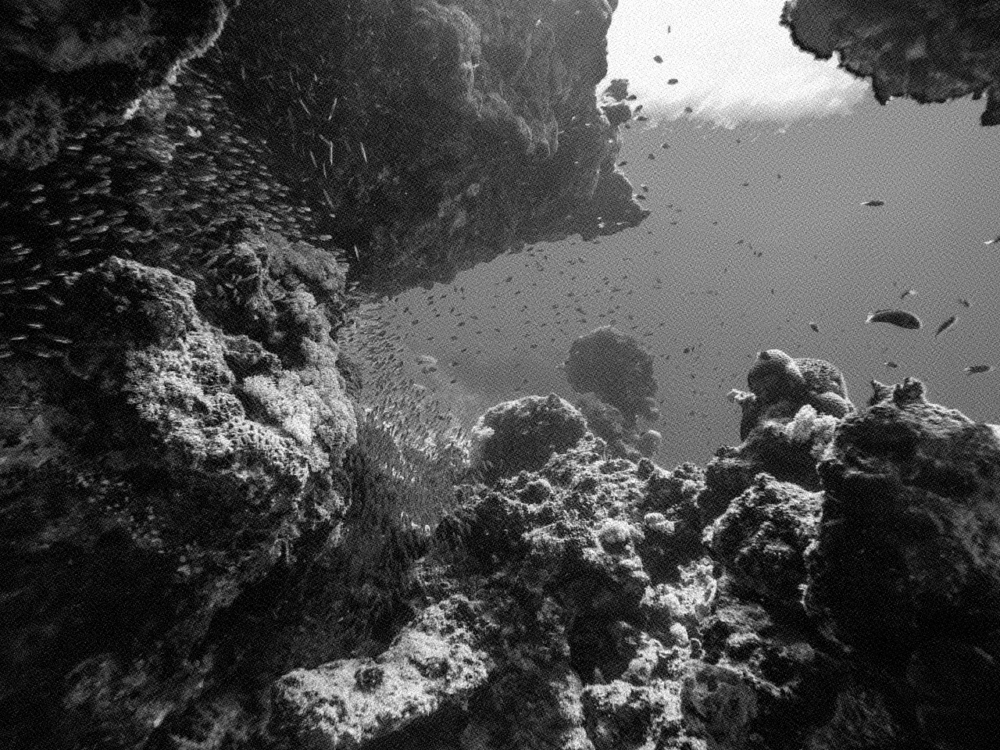

Sigma: 0.005; PSNR: 9.293490; SSIM: 0.068554


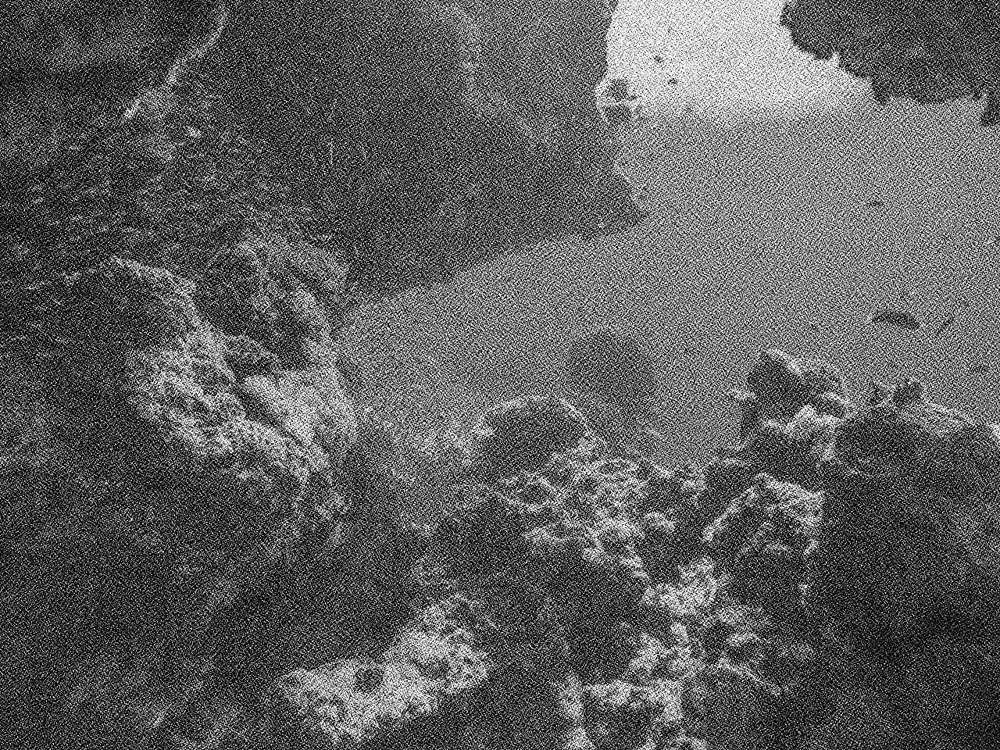

Sigma: 0.01; PSNR: 6.704661; SSIM: 0.030697


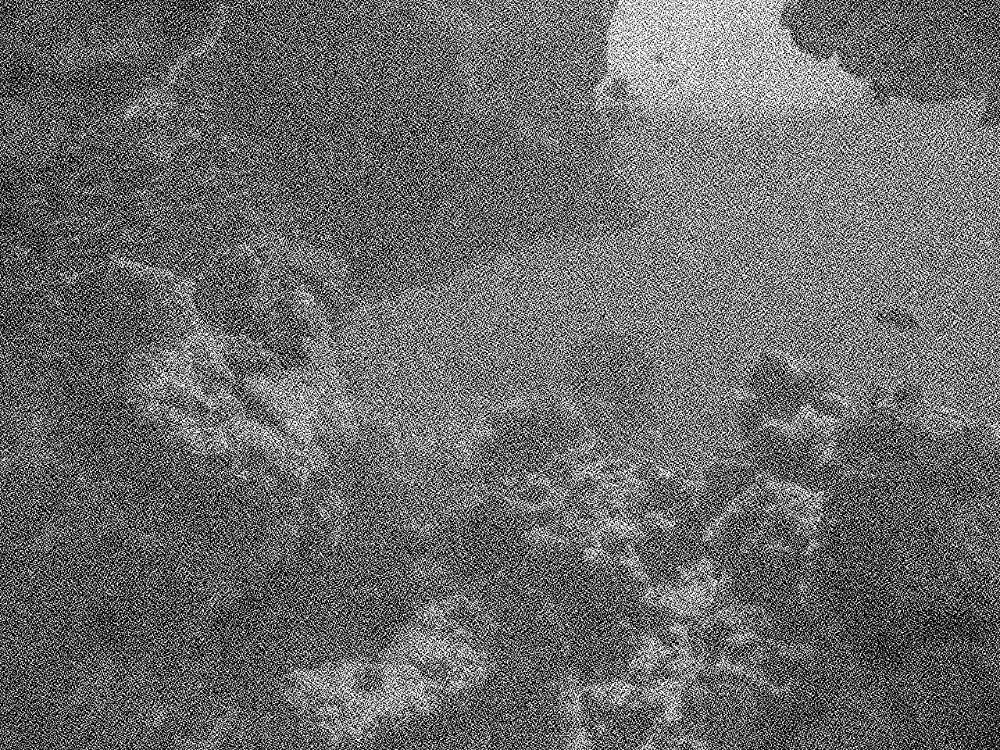

Sigma: 0.05; PSNR: 4.917753; SSIM: 0.012190


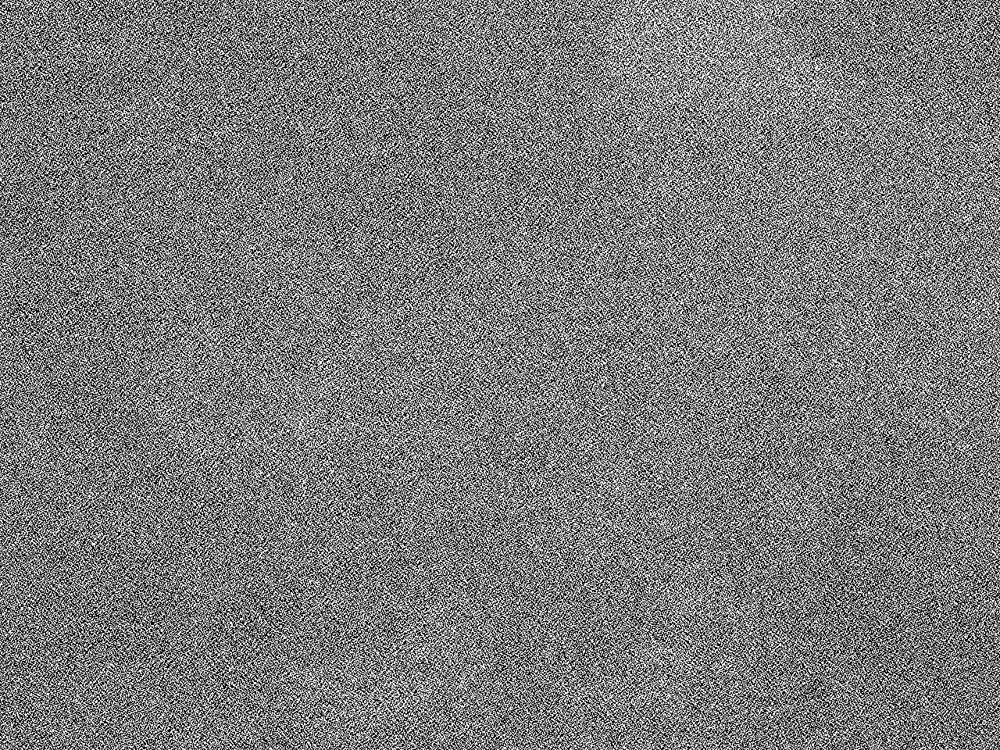

In [7]:
output_cg_normal = []
psnr_cg_normal = []
ssim_cg_normal = []
for sigma, distorted_image in zip(noise_levels, distorted_images):
    o = deblur.deblur_normal(kernel, distorted_image)
    output_cg_normal.append(o)
    
    psnr = compare_psnr(o, image)
    psnr_cg_normal.append(psnr)
 
    ssim = compare_ssim(o, image)
    ssim_cg_normal.append(ssim)
    
    print('Sigma: {}; PSNR: {:.6f}; SSIM: {:.6f}'.format(sigma, psnr, ssim))
    display(util.to_pil(o))

## 2.3 Solve Ridge Regression

The matrix $P^TP$ used in normal equations is symmetric and positive semi-definite. We can also add a digonal matrix to $P^TP$ to make it positive definite. This is equivalent to solve a ridge regression.
$$(P^TP+\mu I)x= P^Tb$$

Sigma: 0; PSNR: 28.756797; SSIM: 0.933189


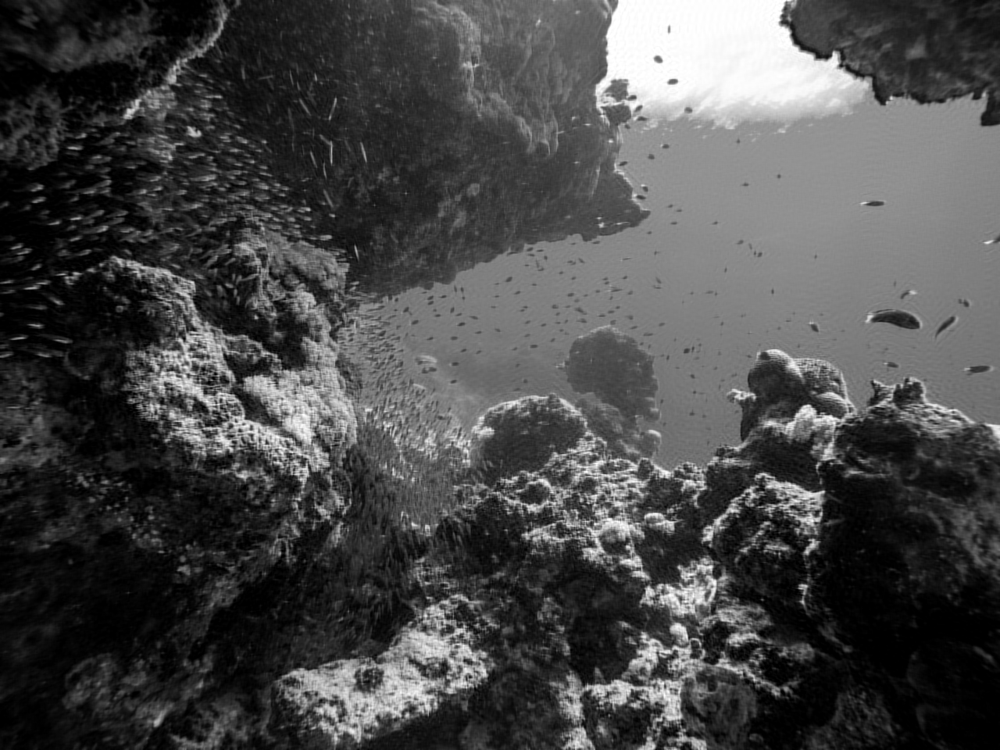

Sigma: 0.0005; PSNR: 28.456629; SSIM: 0.910313


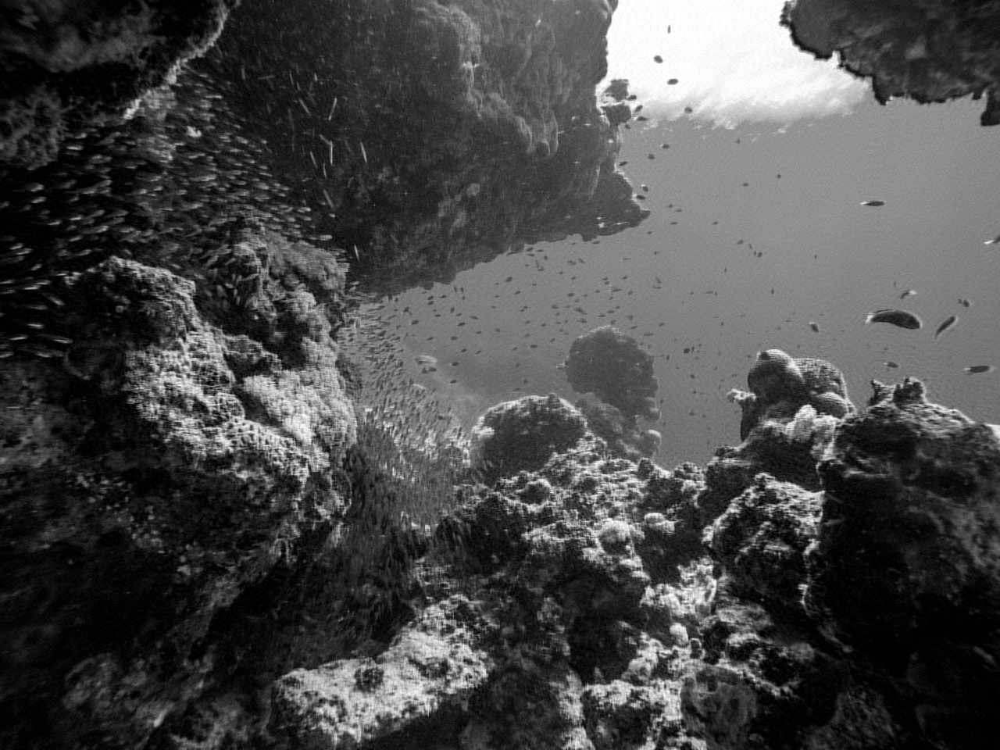

Sigma: 0.001; PSNR: 26.770673; SSIM: 0.890504


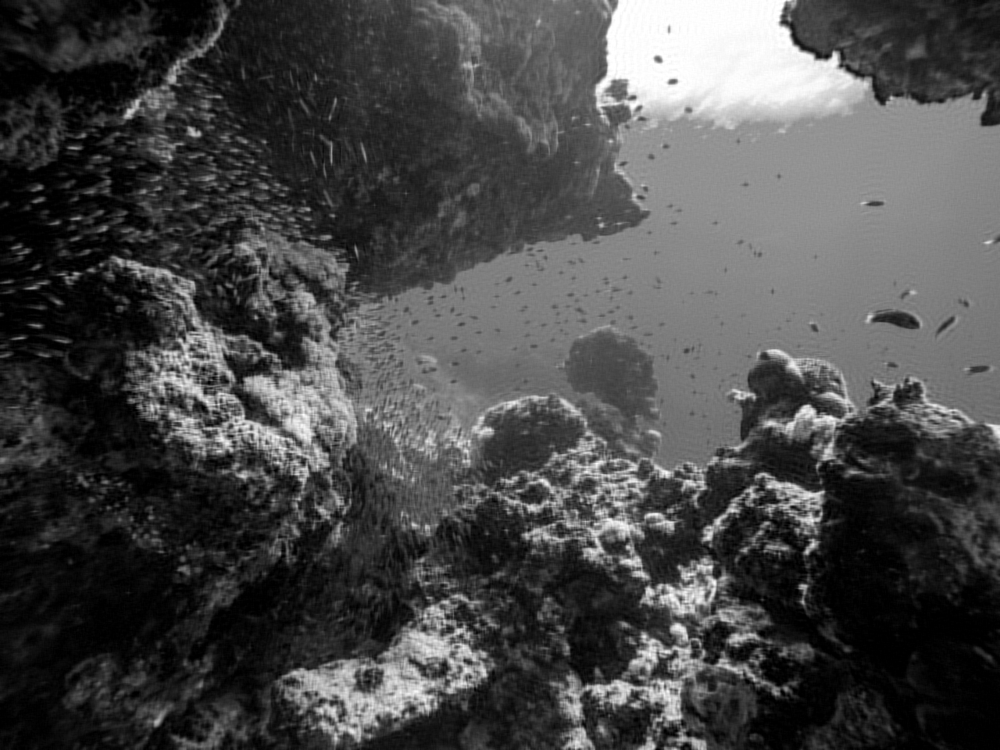

Sigma: 0.005; PSNR: 24.958537; SSIM: 0.834967


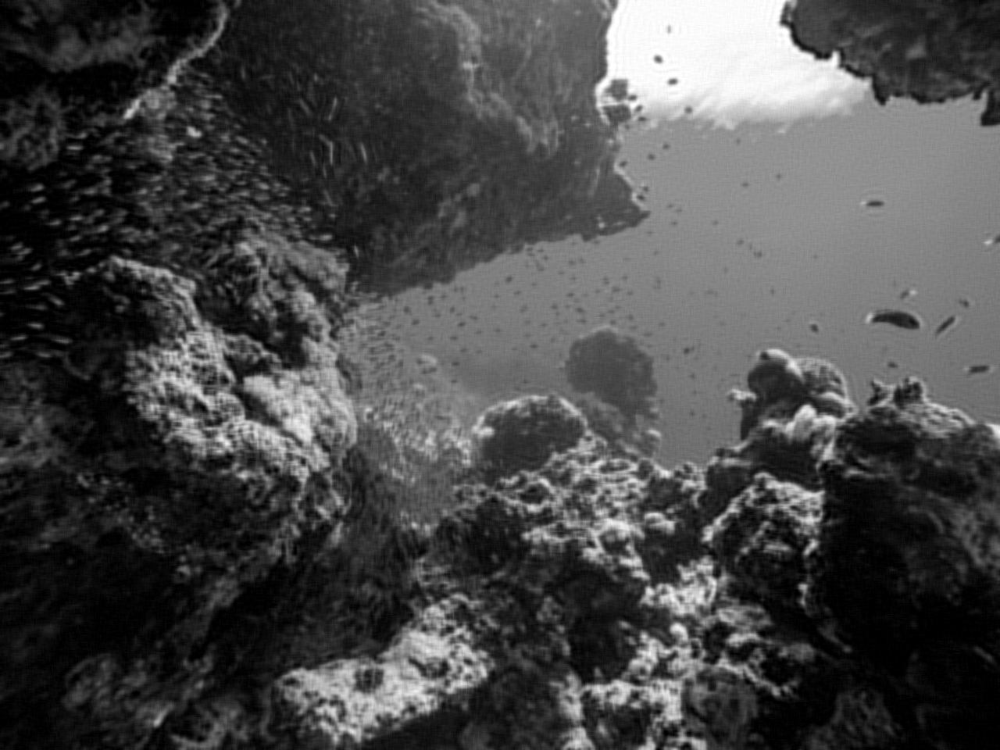

Sigma: 0.01; PSNR: 24.658375; SSIM: 0.800720


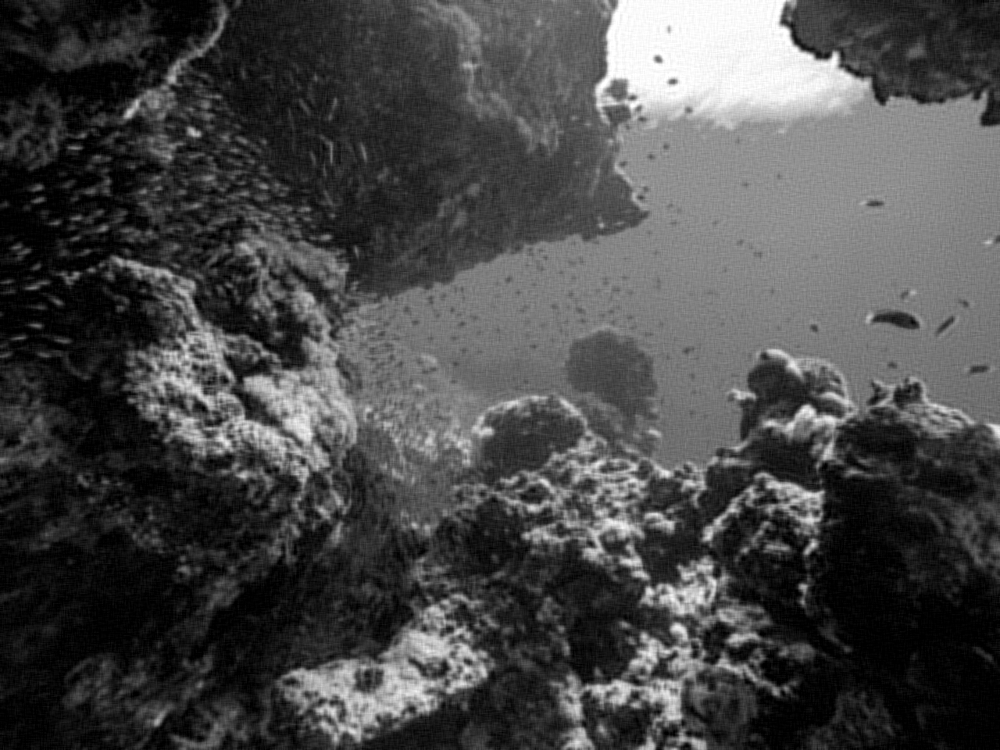

Sigma: 0.05; PSNR: 22.347318; SSIM: 0.739436


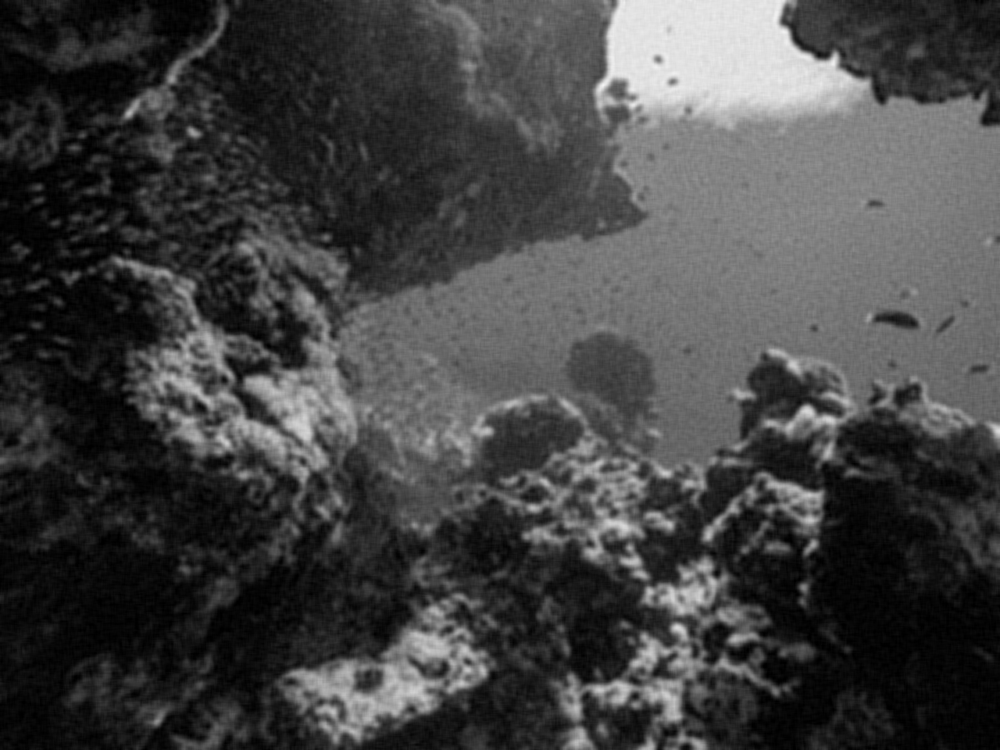

In [8]:
mus = [1e-4, 1e-4, 1e-3, 1e-2, 1e-2, 1e-1]
# mus = [1e-1] * 6
output_cg_ridge = []
psnr_cg_ridge = []
ssim_cg_ridge = []
for sigma, distorted_image, mu in zip(noise_levels, distorted_images, mus):
    o = deblur.deblur_normal(kernel, distorted_image, mu=mu)
    output_cg_ridge.append(o)
    
    psnr = compare_psnr(o, image)
    psnr_cg_ridge.append(psnr)
 
    ssim = compare_ssim(o, image)
    ssim_cg_ridge.append(ssim)
    
    print('Sigma: {}; PSNR: {:.6f}; SSIM: {:.6f}'.format(sigma, psnr, ssim))
    display(util.to_pil(o))

# 3. Total Variation using IRLS

Suppose $D$ is image gradient operator, the problem with Total-Variation norm can be written as
$$\arg\min_x\frac{1}{2}\left\|Px-b\right\|^2_2 + \lambda \text{TV}\left(x\right).$$

## 3.1 Isotropic Total Variation

The Total-Variation term is
$$
\text{TV}\left(x\right) = \sum_i\left(\sqrt{\left|\Delta_i^hx\right|^2+\left|\Delta_i^vx\right|^2}\right) = 
\sum_i\left(\sqrt{\left|\Delta_i^hx\right|^2+\left|\Delta_i^vx\right|^2}\right)^{-1}
\left(\left|\Delta_i^hx\right|^2+\left|\Delta_i^vx\right|^2\right)
$$
where $\Delta_i^hx$ and $\Delta_i^vx$ are horizontal gradient and vertical gradient at pixel $i$, respectively.

Let $$W=\text{diag}\left(\frac{1}{\sqrt{\left|\Delta_i^hx\right|^2+\left|\Delta_i^vx\right|^2}}, i = 1, 2, \dots, \right),$$
we have
$$TV\left(x\right) = \left(D^hx\right)^TWD^hx + \left(D^vx\right)^TWD^vx$$
where $D^h$ and $D^v$ are toeplitz matrix of kernels used to compute horizontal and vertical gradient, respectively.

Let the gradient be zero,
$$
\left(P^TP + \lambda\left((D^h)^TWD^h + (D^v)^TWD^v\right)\right)x = P^Tb.
$$
At every IRLS iteration, solve the equations with conjugate gradient and then update W.

Simga: 0; PSNR: 28.706799; SSIM: 0.930757


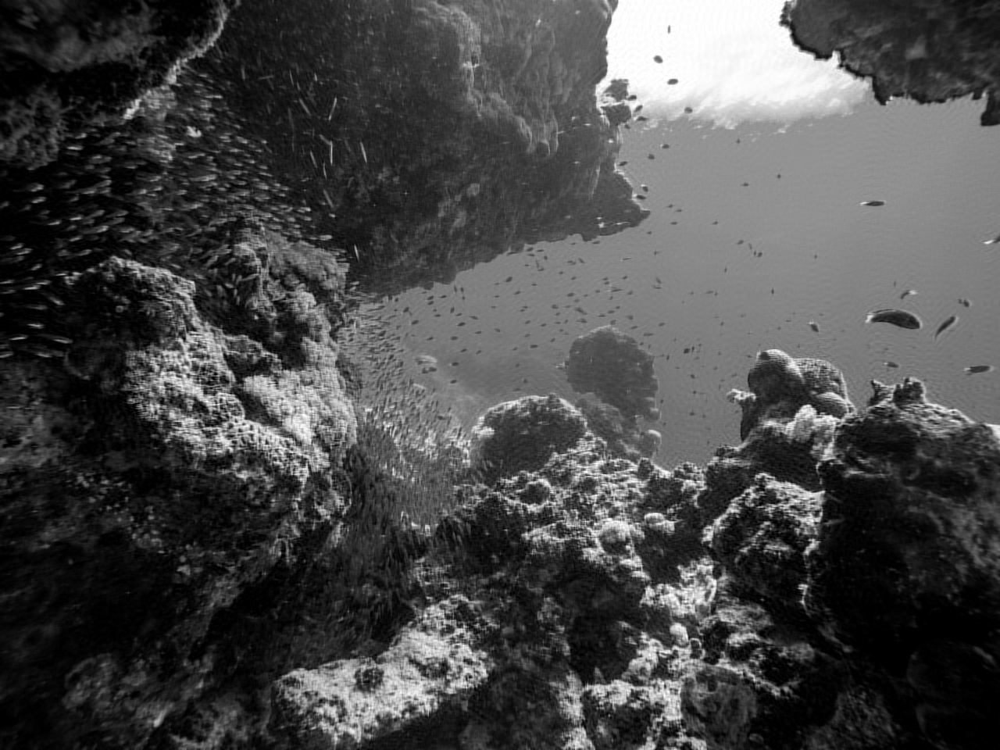

Simga: 0.0005; PSNR: 28.448306; SSIM: 0.916764


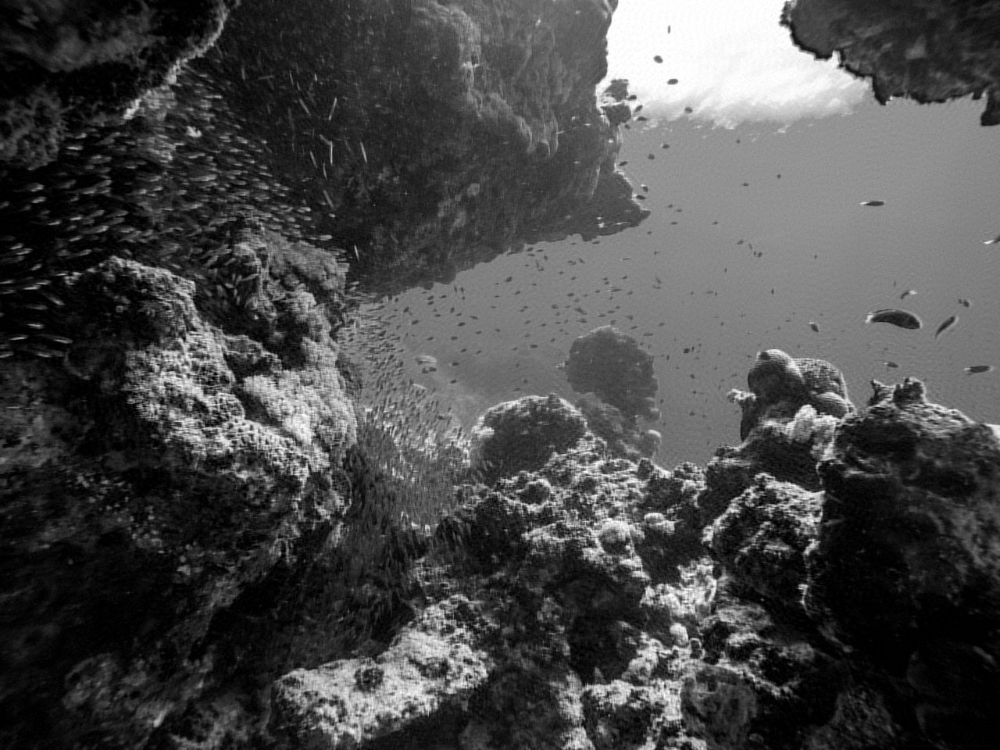

Simga: 0.001; PSNR: 28.277885; SSIM: 0.922977


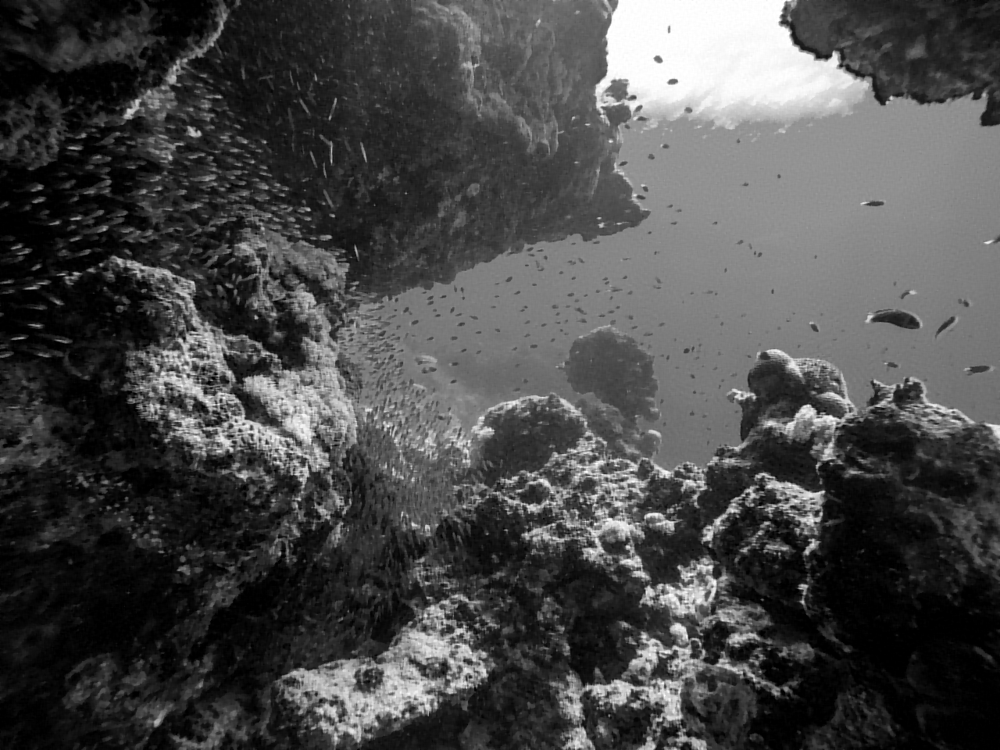

Simga: 0.005; PSNR: 26.311196; SSIM: 0.873071


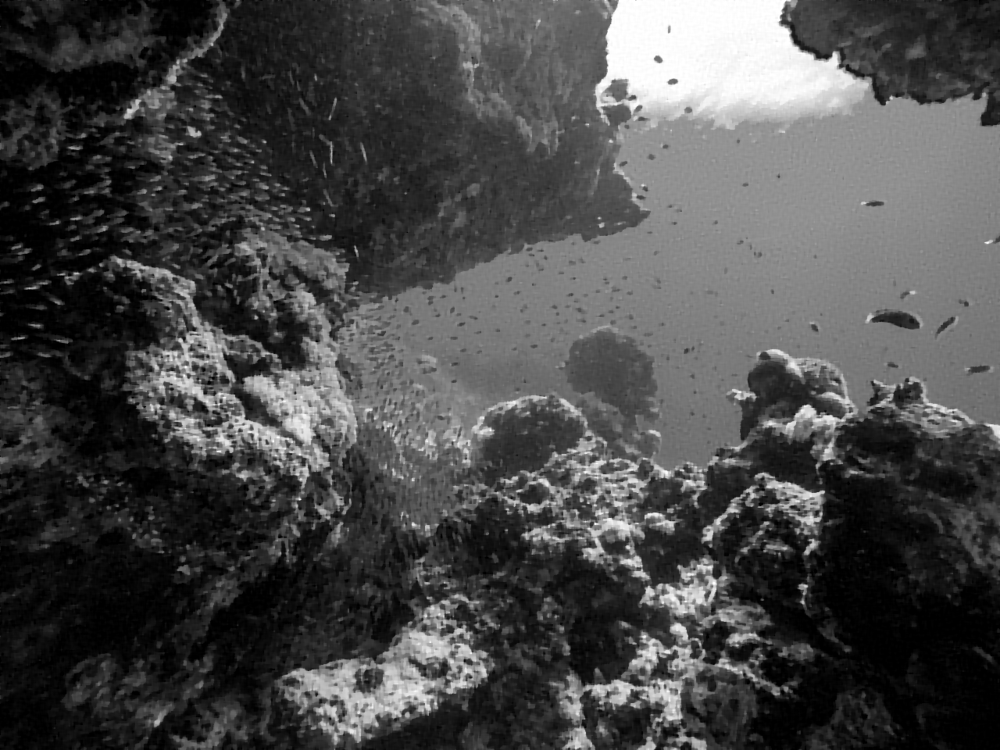

Simga: 0.01; PSNR: 25.044014; SSIM: 0.837961


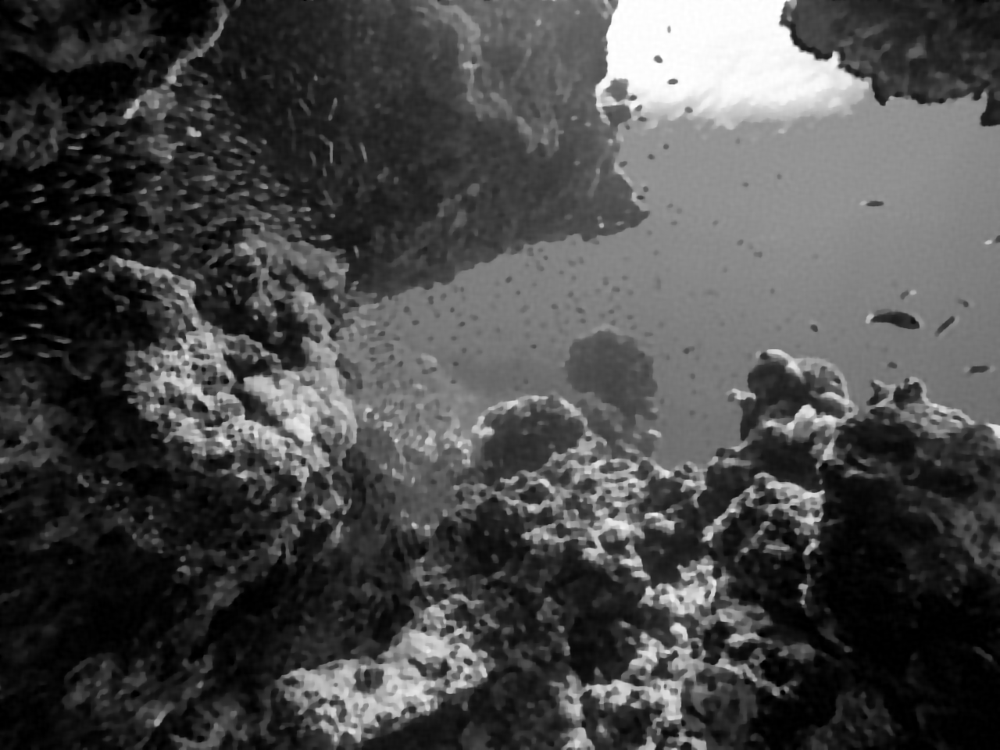

Simga: 0.05; PSNR: 23.628517; SSIM: 0.763078


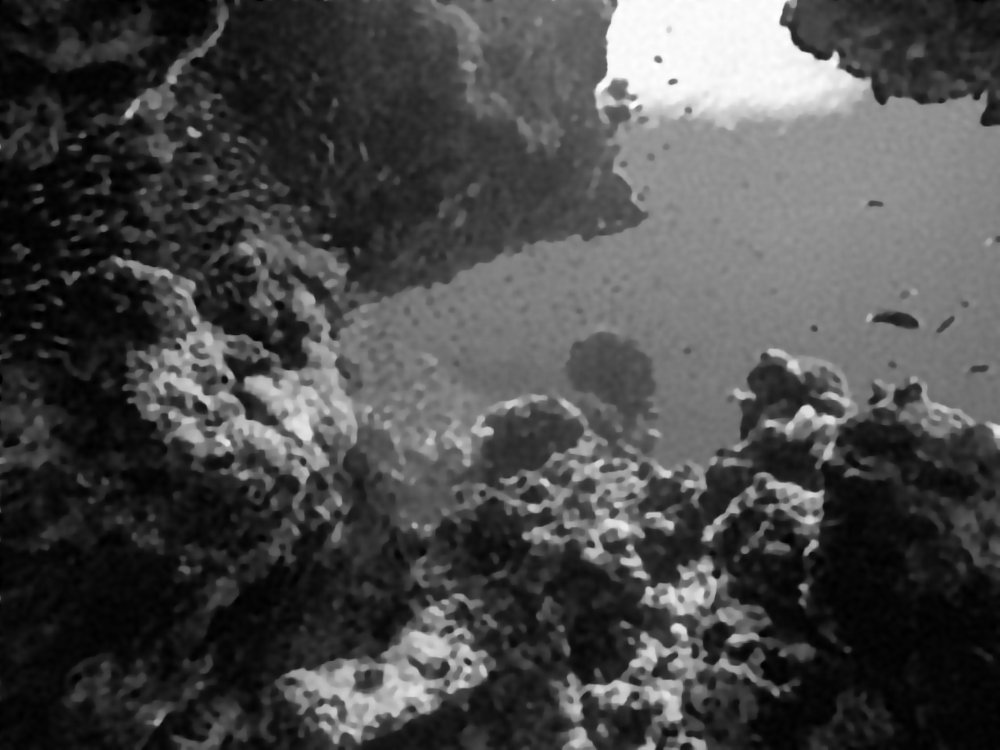

In [9]:
output_itv = []
t_itv = []
loss_itv = []
psnr_itv = []
ssim_itv = []
for sigma, distorted_image, l in zip(noise_levels, distorted_images, lmbda):
#     clear_output()
    o, t, l = deblur.deblur_itv_reweight(kernel, distorted_image, lmbda=l, groundtruth=image)
    output_itv.append(o)
    t_itv.append(t)
    loss_itv.append(l)
    
    psnr = compare_psnr(o, image)
    psnr_itv.append(psnr)
 
    ssim = compare_ssim(o, image)
    ssim_itv.append(ssim)
    
    print('Simga: {}; PSNR: {:.6f}; SSIM: {:.6f}'.format(sigma, psnr, ssim))
    display(util.to_pil(o))

## 3.2 Anisotropic Total Variation

The Total-Variation term is
$$
\text{TV}\left(x\right) = \sum_i\left(\left|\Delta_i^hx\right|+\left|\Delta_i^vx\right|\right) = 
\sum_i\frac{\left|\Delta_i^hx\right|^2}{\left|\Delta_i^hx\right|}
+\sum_i\frac{\left|\Delta_i^vx\right|^2}{\left|\Delta_i^vx\right|}
$$
where $\Delta_i^hx$ and $\Delta_i^vx$ are horizontal gradient and vertical gradient at pixel $i$, respectively.

Let $$W^h=\text{diag}\left(\frac{1}{\left|\Delta_i^hx\right|}, i = 1, 2, \dots, \right)$$
and $$W^v=\text{diag}\left(\frac{1}{\left|\Delta_i^vx\right|}, i = 1, 2, \dots, \right)$$
we have
$$TV\left(x\right) = \left(D^hx\right)^TW^hD^hx + \left(D^vx\right)^TW^vD^vx$$
where $D^h$ and $D^v$ are toeplitz matrix of kernels used to compute horizontal and vertical gradient, respectively.

Let the gradient be zero,
$$
\left(P^TP + \lambda\left((D^h)^TW^hD^h + (D^v)^TW^vD^v\right)\right)x = P^Tb.
$$
At every IRLS iteration, solve the equations with conjugate gradient and then update $W^h$ and $W^v$.

Simga: 0; PSNR: 28.712602; SSIM: 0.930975


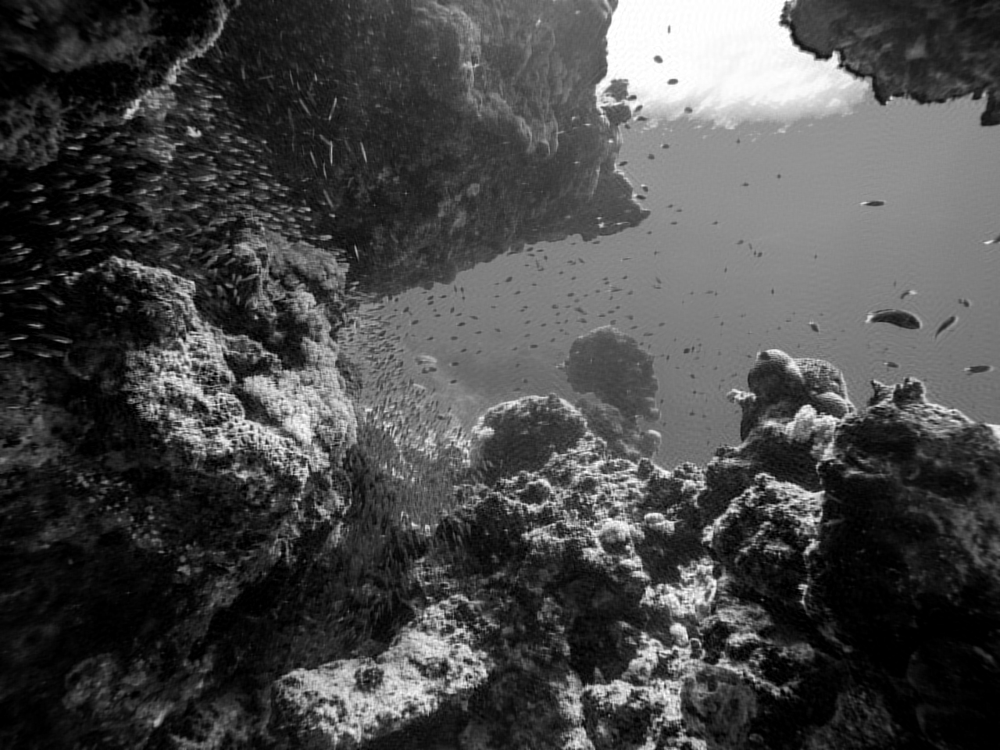

Simga: 0.0005; PSNR: 28.426415; SSIM: 0.917260


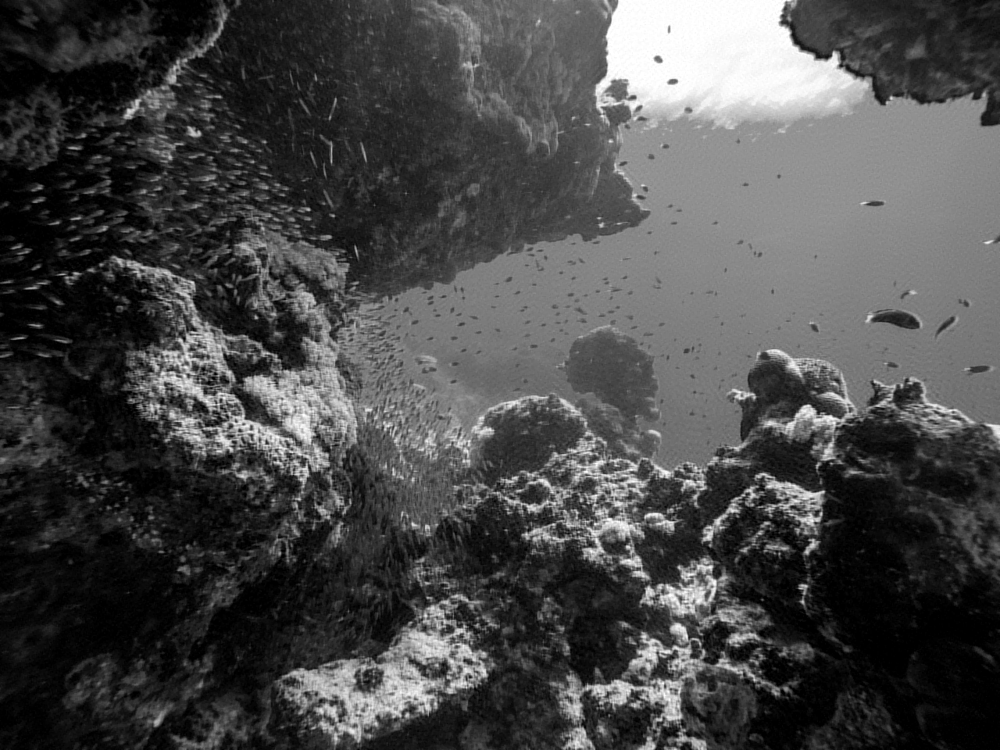

Simga: 0.001; PSNR: 28.170821; SSIM: 0.923558


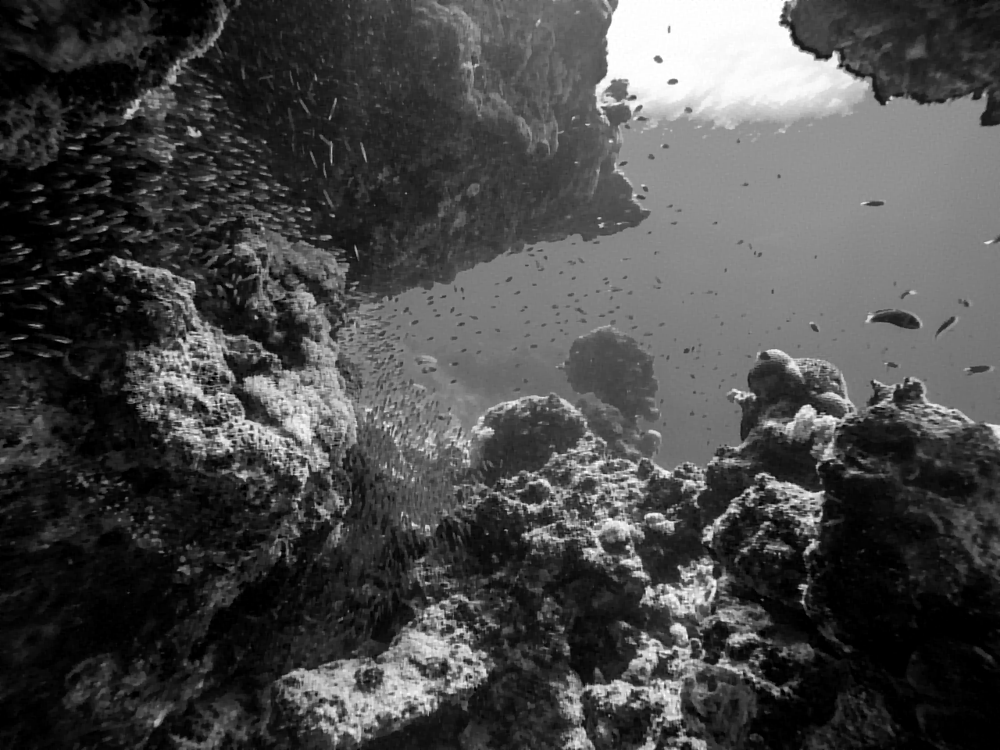

Simga: 0.005; PSNR: 26.011565; SSIM: 0.869646


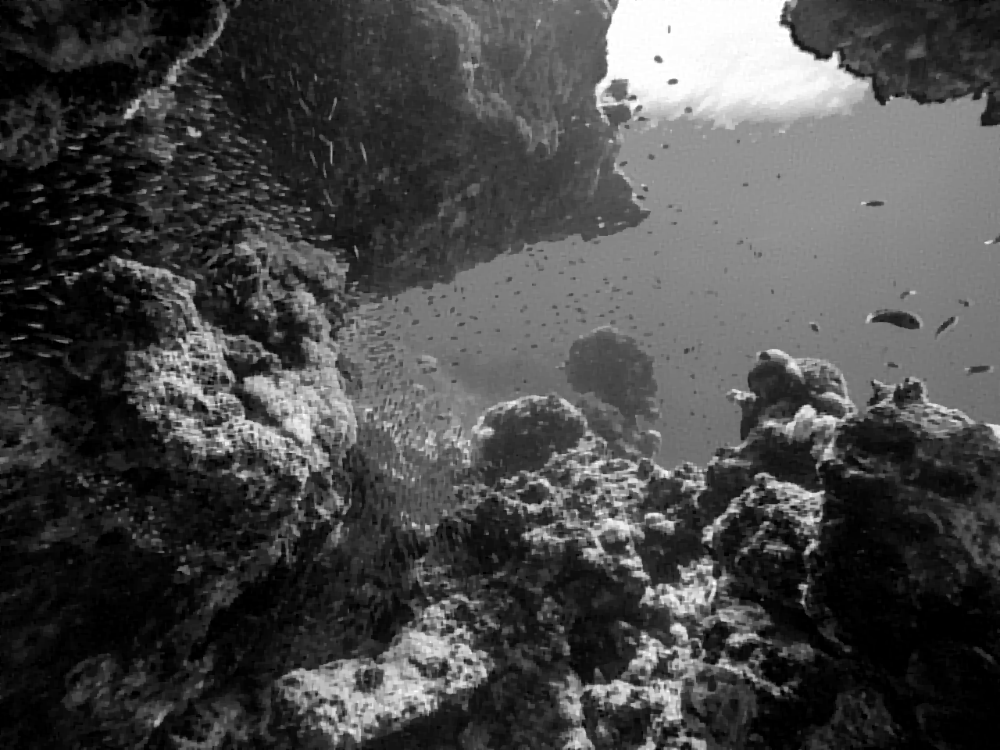

Simga: 0.01; PSNR: 24.649402; SSIM: 0.826652


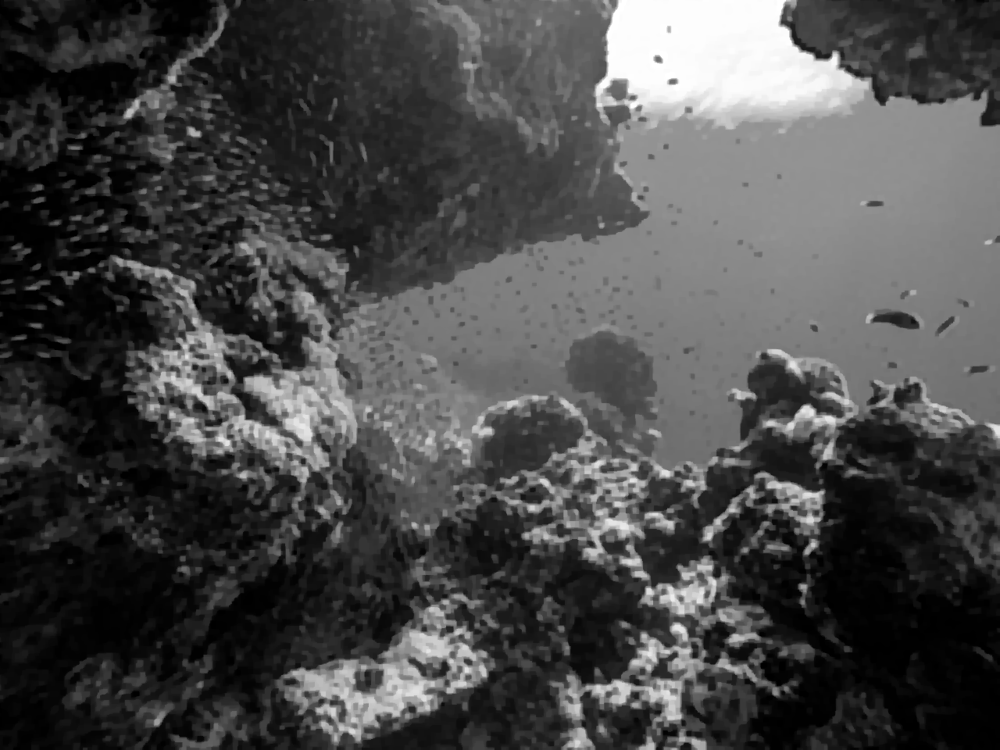

Simga: 0.05; PSNR: 23.359908; SSIM: 0.751574


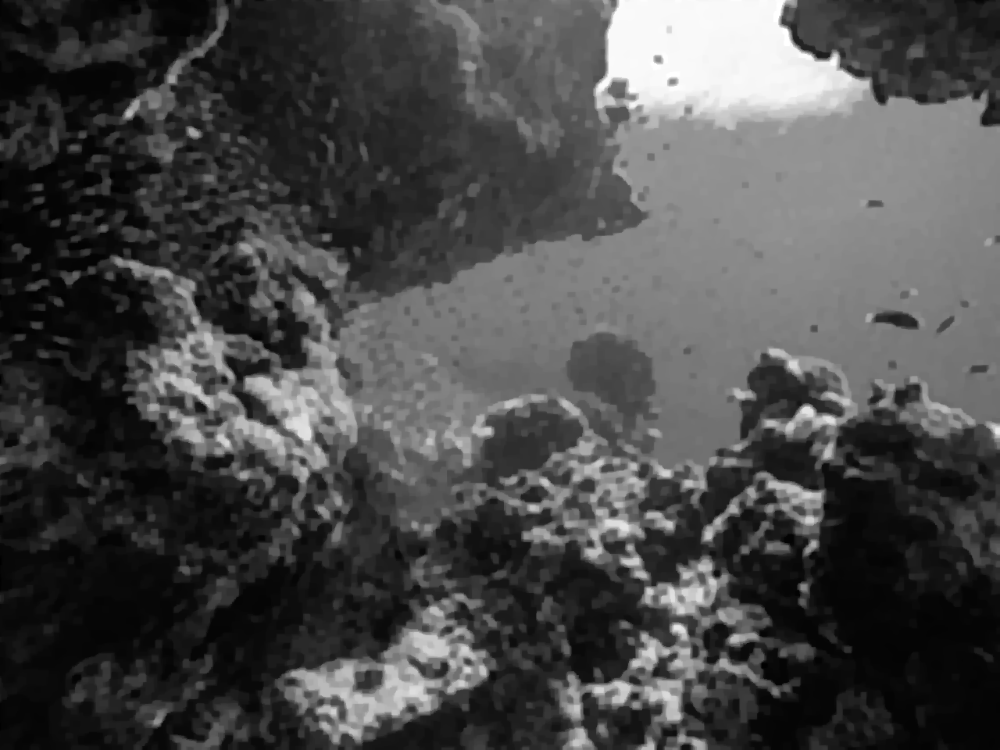

In [10]:
output_atv = []
t_atv = []
loss_atv = []
psnr_atv = []
ssim_atv = []
for sigma, distorted_image, l in zip(noise_levels, distorted_images, lmbda):
#     clear_output()
    o, t, l = deblur.deblur_atv_reweight(kernel, distorted_image, lmbda=l, groundtruth=image)
    output_atv.append(o)
    t_atv.append(t)
    loss_atv.append(l)
    
    psnr = compare_psnr(o, image)
    psnr_atv.append(psnr)
 
    ssim = compare_ssim(o, image)
    ssim_atv.append(ssim)
    
    print('Simga: {}; PSNR: {:.6f}; SSIM: {:.6f}'.format(sigma, psnr, ssim))
    display(util.to_pil(o))

# 4. Fractional Gradient Norms

The Total-Variation term is
$$
\text{TV}\left(x\right) = \sum_i\left(\sqrt{\left|\Delta_i^hx\right|^2+\left|\Delta_i^vx\right|^2}\right)^p = 
\sum_i\left(\sqrt{\left|\Delta_i^hx\right|^2+\left|\Delta_i^vx\right|^2}\right)^{p-2}
\left(\left|\Delta_i^hx\right|^2+\left|\Delta_i^vx\right|^2\right)
$$
where $\Delta_i^hx$ and $\Delta_i^vx$ are horizontal gradient and vertical gradient at pixel $i$, respectively.

Weight matrix used in IRLS iteration is as follows:
$$W=\text{diag}\left(\frac{1}{\left(\sqrt{\left|\Delta_i^hx\right|^2+\left|\Delta_i^vx\right|^2}\right)^{2-p}}, i = 1, 2, \dots, \right).$$

## 4.1 $p=0.8$

Sigma: 0; PSNR: 28.716792; SSIM: 0.931187


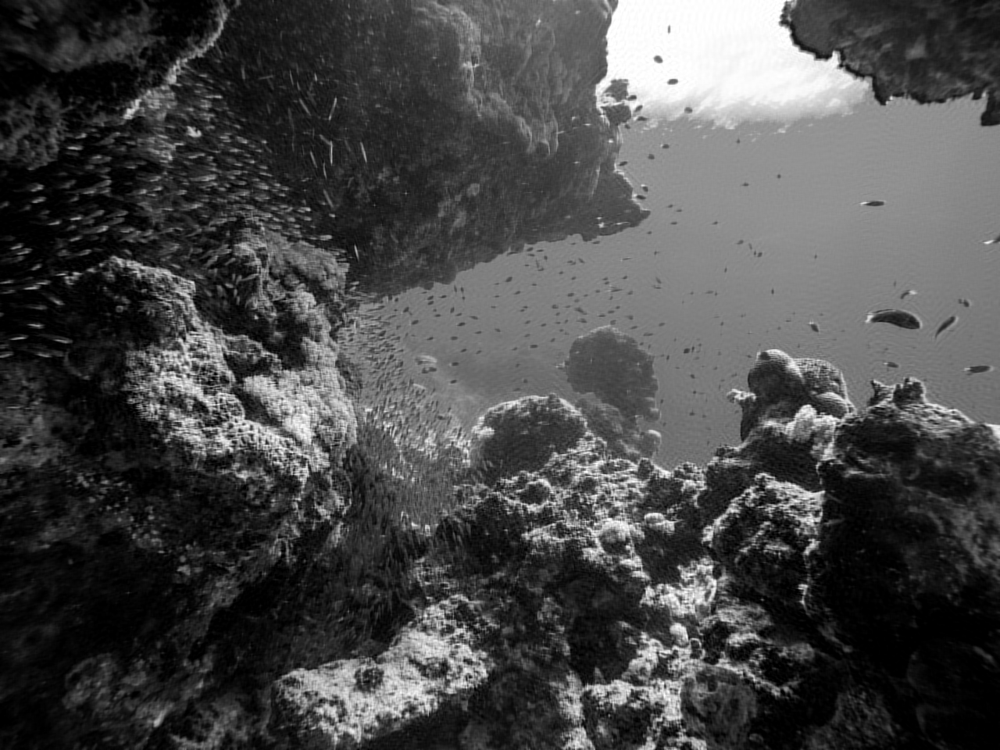

Sigma: 0.0005; PSNR: 28.525914; SSIM: 0.922906


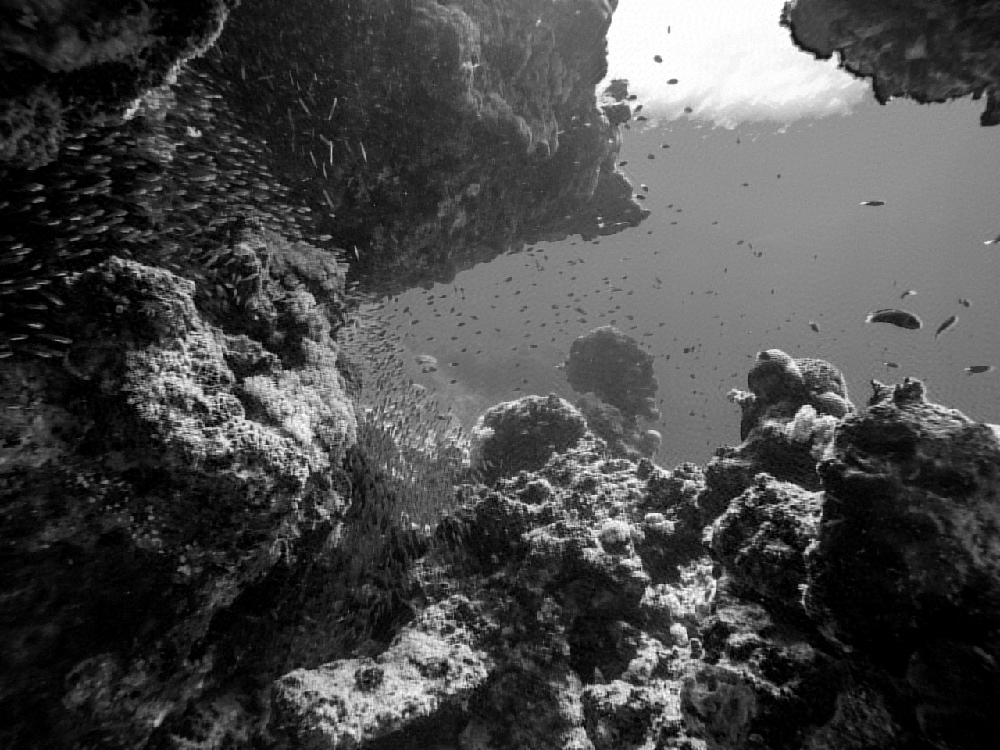

Sigma: 0.001; PSNR: 28.161715; SSIM: 0.924433


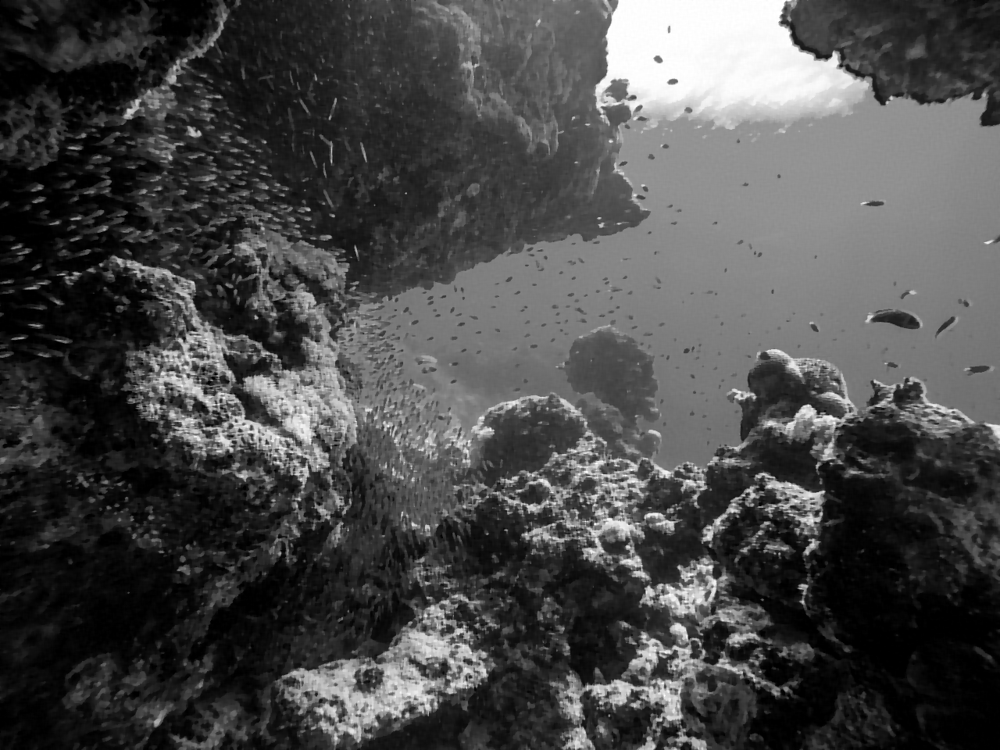

Sigma: 0.005; PSNR: 26.075236; SSIM: 0.873843


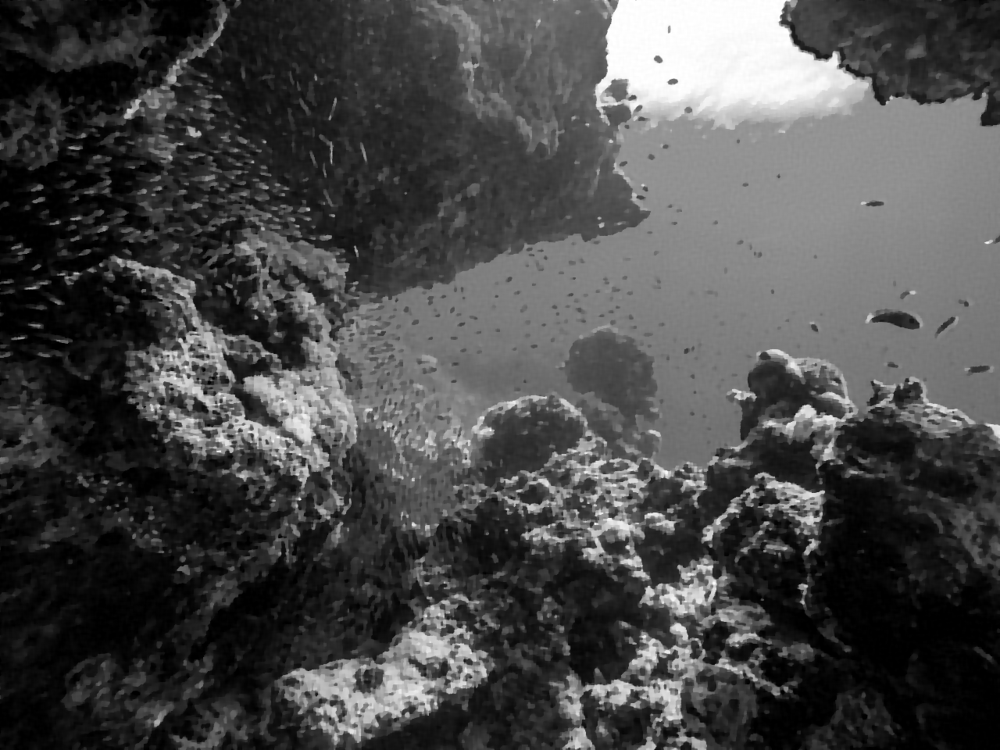

Sigma: 0.01; PSNR: 24.571226; SSIM: 0.822083


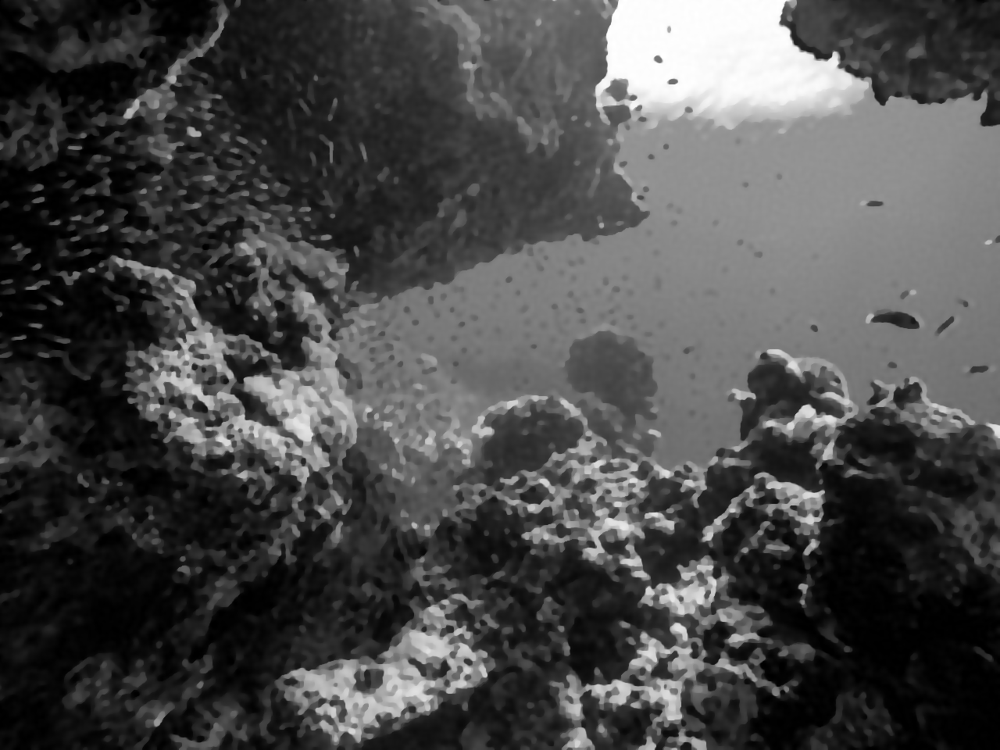

Sigma: 0.05; PSNR: 23.288390; SSIM: 0.748696


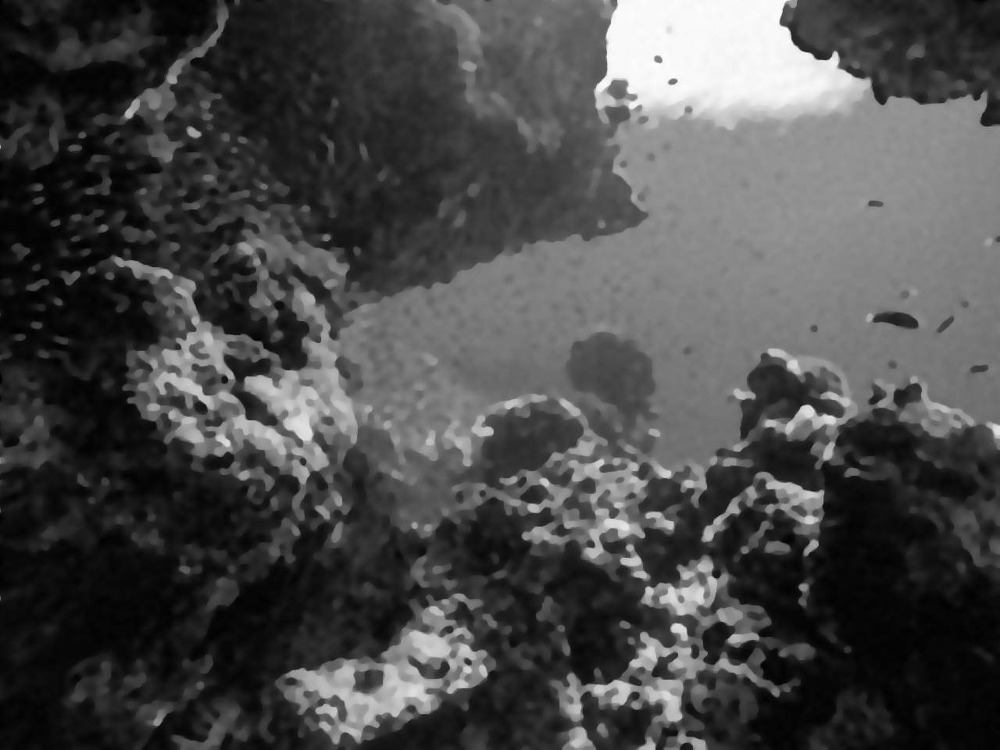

In [ ]:
output_itv_8 = []
t_itv_8 = []
loss_itv_8 = []
psnr_itv_8 = []
ssim_itv_8 = []
for sigma, distorted_image, l in zip(noise_levels, distorted_images, lmbda):
#     clear_output()
    o, t, l = deblur.deblur_itv_reweight(kernel, distorted_image, p=0.8, lmbda=l, groundtruth=image)
    output_itv_8.append(o)
    t_itv_8.append(t)
    loss_itv_8.append(l)

    psnr = compare_psnr(o, image)
    psnr_itv_8.append(psnr)
 
    ssim = compare_ssim(o, image)
    ssim_itv_8.append(ssim)
    
    print('Sigma: {}; PSNR: {:.6f}; SSIM: {:.6f}'.format(sigma, psnr, ssim))
    display(util.to_pil(o))

## 4.2 $p=0.6$

Sigma: 0; PSNR: 28.738011; SSIM: 0.932092


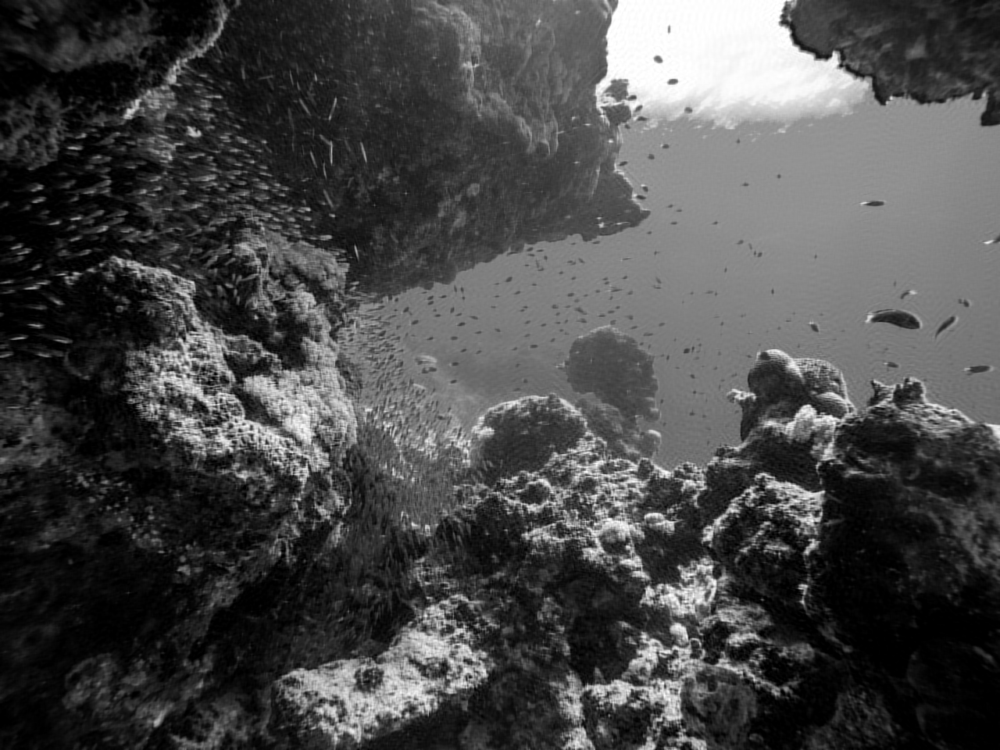

In [ ]:
output_itv_6 = []
t_itv_6 = []
loss_itv_6 = []
psnr_itv_6 = []
ssim_itv_6 = []
for sigma, distorted_image, l in zip(noise_levels, distorted_images, lmbda):
#     clear_output()
    o, t, l = deblur.deblur_itv_reweight(kernel, distorted_image, p=0.6, lmbda=l, groundtruth=image)
    output_itv_6.append(o)
    t_itv_6.append(t)
    loss_itv_6.append(l)

    psnr = compare_psnr(o, image)
    psnr_itv_6.append(psnr)
 
    ssim = compare_ssim(o, image)
    ssim_itv_6.append(ssim)
    
    print('Sigma: {}; PSNR: {:.6f}; SSIM: {:.6f}'.format(sigma, psnr, ssim))
    display(util.to_pil(o))

# 5. ADMM
Use ADMM to solve Anisotropic Total Variation, 
$$\arg\min_x\frac{1}{2}\left\|Px-b\right\|^2_2 + \lambda\left\|Dx\right\|_1,$$
where $$
D = \left[
\begin{array}{l}
D^h\\
D^v
\end{array}
\right].
$$

Introduce aug variable $z$ to the system:
\begin{eqnarray}
\text{minimize}  && \frac{1}{2}\left\|Px-b\right\|^2_2 + \lambda\left\|z\right\|_1\\
\text{subject to}  && Dx = z.
\end{eqnarray}
Use augmented Lagrangian, we have
$$L(x,z,y) = \frac{1}{2}\left\|Px-b\right\|^2_2+\lambda\left\|z\right\|_1+y^T(Dx-z)+\frac{\rho}{2}\left\|Dx-z\right\|^2_2.$$
The update equations can be formulated as follows:
- $x^{(k+1)} = \arg\min_{x}L_{\rho}\left(x, z^{(k)}, y^{(k)}\right)$
- $z^{(k+1)} = \arg\min_{z}L_{\rho}\left(x^{(k+1)}, z, y^{(k)}\right)$
- $y^{(k+1)} = y^{(k)} + \rho\left(Dx^{(k+1)} - z^{(k+1)}\right).$





## 5.1 Update $x$
The gradient of 
$$L\left(x, z^{(k)}, y^{(k)}\right) = \frac{1}{2}\left\|Px-b\right\|_2^2+\left(y^{(k)}\right)^TDx + \frac{\rho}{2}\left\|Dx-z^{(k)}\right\|^2_2$$
with respect to $x$ is
$$P^T(Px-b) + D^Ty^{(k)} + \rho D^T\left(Dx - z^{(k)}\right).$$
Let the gradients be zero:
$$\left(P^TP + \rho D^TD\right)x = P^Tb - D^Ty^{(k)} + \rho D^T z^{(k)}$$
We update $x$ by solving above linear equations.

<!--- 
When computing $x^{(k+1)}$, linearize the quadratic term $$\frac{\rho}{2}\left\|Dx-z\right\|^2_2$$ as
$$\rho\left( D^TDx^{(k)} - D^Tz^{(k)} \right)^Tx+\frac{\mu}{2}\left\|x-x^{(k)}\right\|^2_2.$$

The gradient of
$$L\left(x, z^{(k)}, y^{(k)}\right) = \frac{1}{2}\left\|Px-b\right\|^2_2+\left(y^{(k)}\right)^T\left(Dx-z^{(k)}\right)+\rho\left( D^TDx^{(k)} - D^Tz^{(k)}\right)^Tx + \frac{\mu}{2}\left\|x-x^{(k)}\right\|^2_2$$
with respect to $x$ is
$$P^T\left(Px-b\right)+ D^Ty^{(k)}+\rho\left(D^TDx^{(k)}-D^Tz^{(k)}\right) +\mu(x-x^{(k)})$$

We can get $x^{(k+1)}$ form solving the linear equations:
$$(P^TP+\mu I)x  = P^Tb - D^T\left( \rho Dx^{(k)} - \rho z^{(k)} +y^{(k)} \right) + \mu x^{(k)}$$
-->

## 5.2 Update $z$
The (sub)gradient of
$$L\left(x^{(k+1)}, z, y^{(k)}\right) = \lambda\left\|z\right\|_1-\left(y^{(k)}\right)^Tz + \frac{\rho}{2}\left\|Dx^{(k+1)}-z\right\|^2_2$$
with respect to $z_i$ is
$$
\left\{\begin{array}{ll}
    \lambda - y^{(k)} + \rho(z_i-Dx^{(k+1)}), & \text{if } z_i >= 0\\
    -\lambda - y^{(k)} + \rho(z_i-Dx^{(k+1)}), & \text{if } z_i < 0\\
    \end{array}\right.
$$
Then $z$ is caculated as follows:
$$z = \text{softshrink}_{\frac{\lambda}{\rho}}\left( Dx^{(k+1)} + \frac{y^{(k)}}{\rho} \right)$$


In [ ]:
output_admm = []
t_admm = []
loss_admm = []
psnr_admm = []
ssim_admm = []
for sigma, distorted_image, l in zip(noise_levels, distorted_images, lmbda):
#     clear_output()
    o, t, l = deblur.deblur_admm(kernel, distorted_image, lmbda=l, groundtruth=image)
    output_admm.append(o)
    t_admm.append(t)
    loss_admm.append(l)

    psnr = compare_psnr(o, image)
    psnr_admm.append(psnr)
 
    ssim = compare_ssim(o, image)
    ssim_admm.append(ssim)
    
    print('Sigma: {}; PSNR: {:.6f}; SSIM: {:.6f}'.format(sigma, psnr, ssim))
    display(util.to_pil(o))

<!---
i = 0
util.plot_multiple_cost_vs_time([loss_itv[i], loss_atv[i], loss_admm[i]], [t_itv[i], t_atv[i], t_admm[i]], ['ITV','ATV','ADMM'], title='sigma={}'.format(noise_levels[i]))-->

<!---
util.plot_multiple_cost_vs_time(loss_admm, t_admm, ['simga={}'.format(sigma) for sigma in noise_levels], title='ITV ADMM')-->

<!---
util.plot_multiple_cost_vs_time(loss_itv, t_itv, ['simga={}'.format(sigma) for sigma in noise_levels], title='ITV IRLS')
-->

<!---
util.plot_multiple_cost_vs_time(loss_atv, t_atv, ['simga={}'.format(sigma) for sigma in noise_levels], title='ATV IRLS')
-->

<!---
util.plot_multiple_metric_vs_time(psnr_admm, noise_levels, ['simga={}'.format(sigma) for sigma in noise_levels], title='ITV ADMM')
-->

# 6. Discussions and Conclusions

## 6.1 Comparison of All Methods
|Methods | Regularizer | Robustness to Noise | Artifacts|
|:--- | :---: | --- | ---:|
|Inverse of $P$|No|Non-robust|Severe|
|Inverse of $P^TP$|No|Robust to small noise|Severe|
|Inverse of $(P^TP+\mu I)$|$\ell_2$|Robust to all levels of noise|Severe|
| IRLS-ATV | $\text{TV}_2$ | Highly Robust to all levels of noise | Much Less|
| IRLS-ATV-p | $\text{TV}_2^p$ | Highly Robust to all levels of noise | Much Less|
| IRLS-ITV | $\text{TV}_1$ | Highly Robust to all levels of noise | Much Less|
| ADMM-ITV | $\text{TV}_1$ | Highly Robust to all levels of noise | Much Less|
- Least-Squares-based methods tend to produce severe artifacts.
- A regularizer can greatly improve models robustness to noise.
- Choosing weight for regularizer needs tweaking.

## 6.2 TODO
- Compare different algorithms for different kernels (synthetic and natural).